# Plant Seedlings Classification
# Plant Seedlings – Image classification using CNN & Tensorflow

## Data Description:
You are provided with a dataset of images of plant seedlings at various stages of grown. Each image has a filename that is its unique id. The dataset comprises 12 plant species. The goal of the project is to create a classifier capable of determining a plant's species from a photo.

### Dataset 
The data file names are:
* images.npy
* Label.csv

## Objective

To build a classification model that capable of determining a plant's species from a photo.

* **Loose Silky-bent**            
* **Common Chickweed**            
* **Scentless Mayweed**           
* **Small-flowered Cranesbill**    
* **Fat Hen**                      
* **Charlock**                     
* **Sugar beet**                   
* **Cleavers**                     
* **Black-grass**                  
* **Shepherds Purse**              
* **Common wheat**                 
* **Maize**                     

## Solution Approach - CNN Image classification

* **Load dataset and Summary**
  * Load Data Images & labels
* **Understand given data**
  * Check for Size/Duplicates/Null values/Sample data
* **Exploratory Data Analysis and Insights**
  * Plot the images from each class and with their corresponding labels
  * Plot the mean images for each class
  * List all Key meaningful observations
* **Data pre-processing**
  * Prepare the data for analysis
  * Remove unwanted noise from the images using Guassian Blurring
  * Normalization
  * Plot the images before and after the pre-processing steps ( Blurring & Normalization ) 
* **Data preparation**
  * Split the target variable and predictors
  * Split the data into train and test 
  * Data scaling
  * Convert labels from digits to one hot vector. 
  * Check the shape of the data.
  * Reshape the data into shapes compatible with Keras models, if already not compatible.
* **Model building & Model Performance Improvement**
 * Build Convolution Neural Network
 * Performance Tuned Model - Check Performance & Hyper Parameters Tuning
 * Compare Models - Evaluate the model on different performance metrics and comment on the performance and scope of improvement.
* **Conclusion and key takeaways**




# Plant Seedlings Classification


## Understand Given Data

Load given data `images.npy & Labels.csv` to numpy array & data frame and understand data, data type, data nature,  features incuded, total records,data has any missing values or duplicate data. 

Visualize data and and understand data range 

### Loading necessary libraries for  EDA

Load all standard python library packages.

#### Data Manipulation
* Numpy
* Pandas

#### Data Visualization
* matplotlib.pyplot
* seaborn




In [1]:
# Colab setup style blackcellmagic
import os, sys, subprocess
if "google.colab" in sys.modules:
    cmd = "pip install --upgrade watermark blackcellmagic"
    process = subprocess.Popen(cmd.split(), stdout=subprocess.PIPE)



### Time everything in IPython

In [2]:
# Install ipython-autotime
!pip install ipython-autotime

In [3]:

# import OS module
import os

# this will help in making the Python code more structured automatically
%load_ext blackcellmagic
%load_ext autotime

import warnings

warnings.filterwarnings("ignore")


# Libraries to help with reading and manipulating data

import pandas as pd
import numpy as np

# Libraries to help with data visualization
import matplotlib.pyplot as plt
import seaborn as sns

# Removes the limit for the number of displayed columns
pd.set_option("display.max_columns", None)
# Sets the limit for the number of displayed rows
pd.set_option("display.max_rows", 200)



time: 364 ms (started: 2022-02-09 12:35:21 +00:00)


## Load data

Read given `images.npy & Labels.csv ` and load to numpy array & data frame 

Load data based on environment, if Colab then load data from google drive else from local system

In [4]:

images_path = "/content/drive/My Drive/ML/data_sets/plant_seed_classification/images.npy"
labels_path = "/content/drive/My Drive/ML/data_sets/plant_seed_classification/Labels.csv"

if "google.colab" in sys.modules:
    from google.colab import drive
    # reading csv data given from bank and load to data frame
    drive.mount('/content/drive/')



    # Read labels 

    seed_labels_data = pd.read_csv(labels_path)
    # copying orignal data so that when changing data we dont lose original
    data_labels = seed_labels_data.copy()

    # Read images
    images_data = np.load(images_path)
    # copying orignal data so that when changing data we dont lose original
    data = images_data.copy()

    print(f"Type of data_labels : {type(data_labels)}")
    print(f"Type of data : {type(data)}")

Drive already mounted at /content/drive/; to attempt to forcibly remount, call drive.mount("/content/drive/", force_remount=True).
Type of data_labels : <class 'pandas.core.frame.DataFrame'>
Type of data : <class 'numpy.ndarray'>
time: 1.01 s (started: 2022-02-09 12:35:21 +00:00)


### View the first and last 5 rows of the dataset.

In [5]:
#!ls drive/MyDrive/ML/data_sets/plant_seed_classification

time: 905 µs (started: 2022-02-09 12:35:22 +00:00)


In [6]:
data_labels.head(5)

,Label
0,Small-flowered Cranesbill
1,Small-flowered Cranesbill
2,Small-flowered Cranesbill
3,Small-flowered Cranesbill
4,Small-flowered Cranesbill


time: 6.61 ms (started: 2022-02-09 12:35:22 +00:00)


In [7]:
data_labels.tail(5)

,Label
4745,Loose Silky-bent
4746,Loose Silky-bent
4747,Loose Silky-bent
4748,Loose Silky-bent
4749,Loose Silky-bent


time: 4.55 ms (started: 2022-02-09 12:35:22 +00:00)


### Understand the shape of the dataset.

In [8]:
#Images & Labels shape

print(f"Images shape : {data.shape}, And Labels shape : {data_labels.shape}")

Images shape : (4750, 128, 128, 3), And Labels shape : (4750, 1)
time: 894 µs (started: 2022-02-09 12:35:22 +00:00)


**Observations on data** 

* We have 4750 data samples 
* Given images height & width are 128 * 128, Colour Images since it has 3 Dimensions for R, G & B 




# Exploratory Data Analysis And Data processing 

## Checking Min & Max Values

**Image should range values from 0 to 255 only**

In [9]:
print(f"Image data Min value : {np.min(data)}, Max Value : {np.max(data)}")

Image data Min value : 0, Max Value : 255
time: 449 ms (started: 2022-02-09 12:35:22 +00:00)


**All values in images data range from 0 to 255. No invalid data.**

In [10]:
#  Prints total null value count(s) for all columns in input data frame
def print_null_info(df):
    """
    Prints total null value count(s) & % for all columns in input data frame
    """

    nullInfo = {"missing count": df.isnull().sum(), "missing %": df.isnull().mean()}
    # Creates pandas DataFrame.
    nulldata = pd.DataFrame(nullInfo)
    return nulldata[nulldata["missing count"] > 0].sort_values(
        by="missing count", ascending=False
    )


#    Prints unique value counts, top 10 value & count(s) for all category columns in input data frame
def print_category_value_counts(df, column_names):
    """
    Prints unique value counts, top 10 value & count(s) for all category columns in input data frame
    """
    print()
    for typeval, col in zip(df[column_names].dtypes, df[column_names]):
        print()
        print(f"Column name : {col} has total {df[col].nunique()} unique values")
        print()
        print(df[col].value_counts())
        print()
        print("-" * 50)


print_null_info(data_labels)

,missing count,missing %


time: 20.2 ms (started: 2022-02-09 12:35:23 +00:00)



Given data has no missing values or duplicates. We dont need to check for outliers in this data. 

### Labeled barplots


In [11]:

# function to create labeled barplots


def labeled_barplot(data, feature, perc=False, n=None):
    """
    Barplot with percentage at the top

    data: dataframe
    feature: dataframe column
    perc: whether to display percentages instead of count (default is False)
    n: displays the top n category levels (default is None, i.e., display all levels)
    """

    total = len(data[feature])  # length of the column
    count = data[feature].nunique()
    if n is None:
        plt.figure(figsize=(count + 1, 5))
    else:
        plt.figure(figsize=(n + 1, 5))

    plt.xticks(rotation=90, fontsize=15)
    ax = sns.countplot(
        data=data,
        x=feature,
        palette="Paired",
        order=data[feature].value_counts().index[:n].sort_values(),
    )

    for p in ax.patches:
        if perc == True:
            label = "{:.1f}%".format(
                100 * p.get_height() / total
            )  # percentage of each class of the category
        else:
            label = p.get_height()  # count of each level of the category

        x = p.get_x() + p.get_width() / 2  # width of the plot
        y = p.get_height()  # height of the plot

        ax.annotate(
            label,
            (x, y),
            ha="center",
            va="center",
            size=12,
            xytext=(0, 5),
            textcoords="offset points",
        )  # annotate the percentage

    plt.show()  # show the plot


time: 14 ms (started: 2022-02-09 12:35:23 +00:00)


###  Analysis on Seed Label
**Data Distribution**

In [12]:

# Print all label & counts 
print_category_value_counts(data_labels, ["Label"])



Column name : Label has total 12 unique values

Loose Silky-bent             654
Common Chickweed             611
Scentless Mayweed            516
Small-flowered Cranesbill    496
Fat Hen                      475
Charlock                     390
Sugar beet                   385
Cleavers                     287
Black-grass                  263
Shepherds Purse              231
Common wheat                 221
Maize                        221
Name: Label, dtype: int64

--------------------------------------------------
time: 4.63 ms (started: 2022-02-09 12:35:23 +00:00)


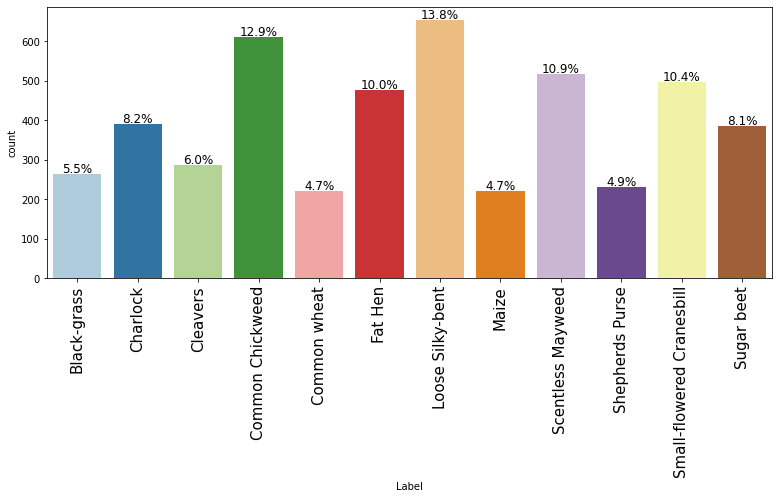

time: 262 ms (started: 2022-02-09 12:35:23 +00:00)


In [13]:
# Observations on Label
labeled_barplot(data_labels, "Label", True)

###  Observations on Seed Label

* We have 12 different seeds 
* Loose Silky-bent & Common Chickweed are most dominant with 14% and 13%.
* Maize are Common wheat & least dominant with 4.7% each


## Collect Index values for Seed Types

In [14]:
# Collect all seed index values for future image plots and processing 

seed_types = data_labels['Label'].unique()

# print seed index - reqd for one hot encoding 

for i in range(0, len(seed_types)):
  print(f"Seed type({seed_types[i]}) has index ({i})")

print()
print()
seed_label_index = []
for seed in seed_types:
  #print(seed)
  index_vals = data_labels[data_labels['Label']==seed].index.values
  seed_label_index.append(index_vals)
  print(f"Seed type({seed}) has total index : ({len(index_vals)}) ")

# seed_label_index has all seed type and its index values

Seed type(Small-flowered Cranesbill) has index (0)
Seed type(Fat Hen) has index (1)
Seed type(Shepherds Purse) has index (2)
Seed type(Common wheat) has index (3)
Seed type(Common Chickweed) has index (4)
Seed type(Charlock) has index (5)
Seed type(Cleavers) has index (6)
Seed type(Scentless Mayweed) has index (7)
Seed type(Sugar beet) has index (8)
Seed type(Maize) has index (9)
Seed type(Black-grass) has index (10)
Seed type(Loose Silky-bent) has index (11)


Seed type(Small-flowered Cranesbill) has total index : (496) 
Seed type(Fat Hen) has total index : (475) 
Seed type(Shepherds Purse) has total index : (231) 
Seed type(Common wheat) has total index : (221) 
Seed type(Common Chickweed) has total index : (611) 
Seed type(Charlock) has total index : (390) 
Seed type(Cleavers) has total index : (287) 
Seed type(Scentless Mayweed) has total index : (516) 
Seed type(Sugar beet) has total index : (385) 
Seed type(Maize) has total index : (221) 
Seed type(Black-grass) has total index : 

## Plot the images from each seed class and with their corresponding labels

**Let's visualize SEED images randomly from each of the 12 classes.** The Image matrix is plotted and each row represents four single channel images corresponding to one class. We have read single channel images in order to reduce complexity. 


### **Importing Tensorflow libraries**

In [15]:
import cv2
import os

import tensorflow as tf
import tensorflow.keras as keras
from tensorflow.keras.models import Sequential #sequential api for sequential model 
from tensorflow.keras.layers import Dense, Dropout, Flatten #importing different layers 
from tensorflow.keras.layers import Conv2D, MaxPooling2D, BatchNormalization, Activation, Input, LeakyReLU,Activation
from tensorflow.keras import backend as K
from tensorflow.keras.utils import to_categorical #to perform one-hot encoding 
from tensorflow.keras.layers import Dense, Dropout, Flatten, Conv2D, MaxPool2D
from tensorflow.keras.optimizers import RMSprop,Adam #optimiers for optimizing the model
from tensorflow.keras.callbacks import EarlyStopping  #regularization method to prevent the overfitting
from tensorflow.keras.callbacks import ModelCheckpoint
from tensorflow.keras.models import Sequential, Model
from tensorflow.keras import losses, optimizers

# import images lib
from tensorflow.keras.preprocessing import image

time: 2.2 s (started: 2022-02-09 12:35:23 +00:00)


In [16]:
#set random seed

tf.random.set_seed(42)
np.random.seed(42)


time: 1.27 ms (started: 2022-02-09 12:35:25 +00:00)


### Before Data Preprocessing - Different Seed Class Images

**Let's visualize SEED images randomly from each of the 12 classes.**

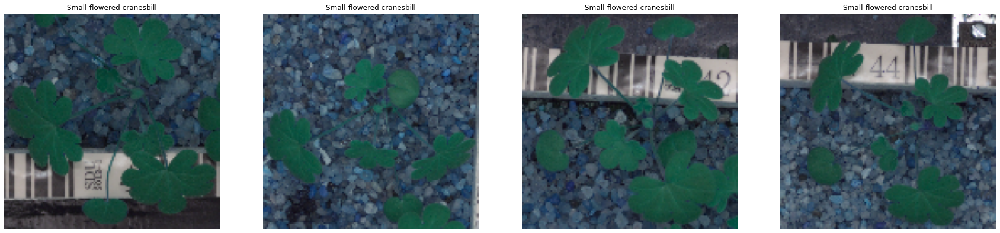

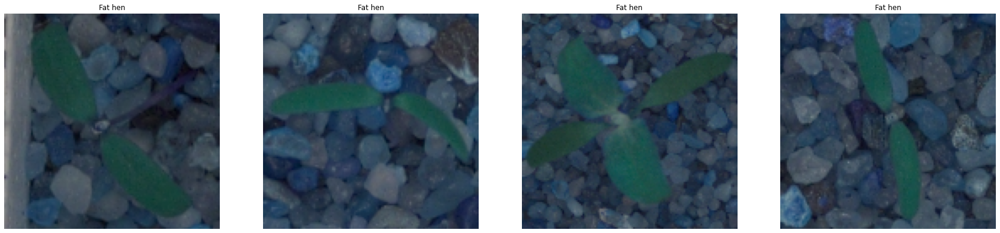

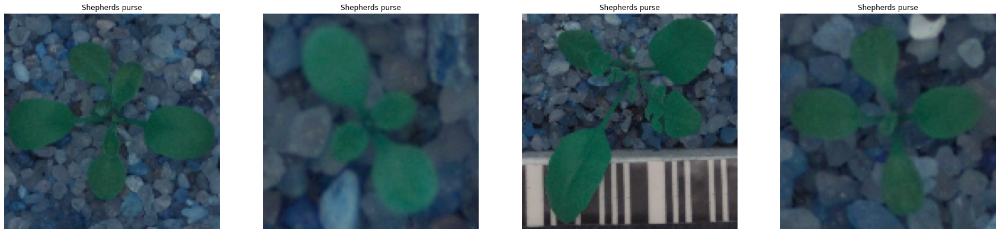

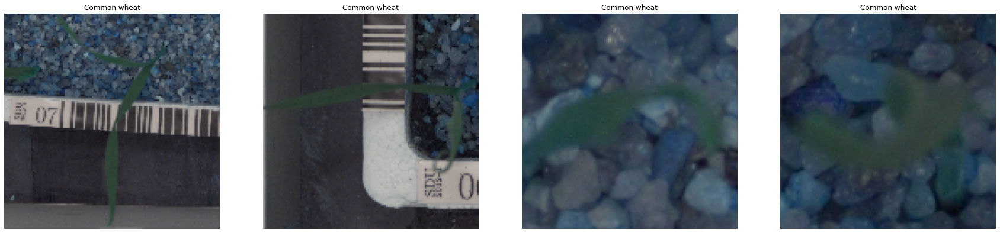

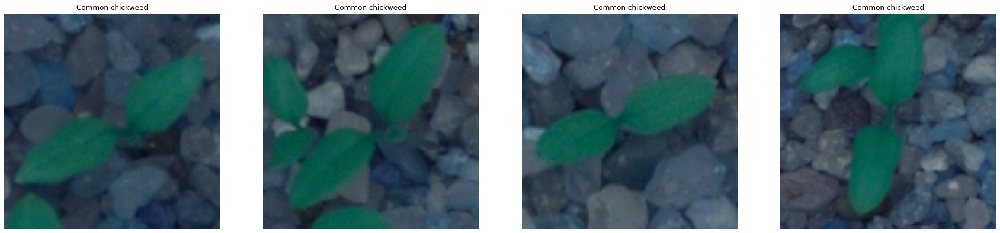

...

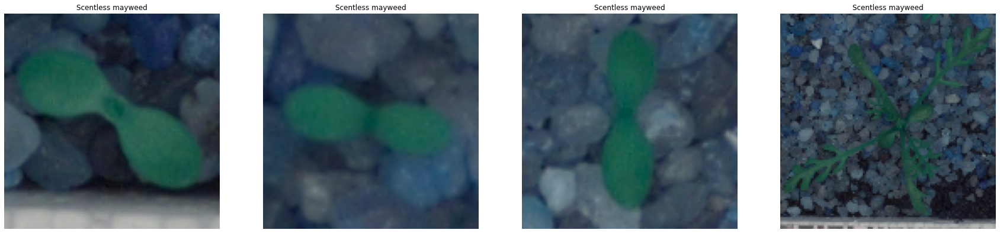

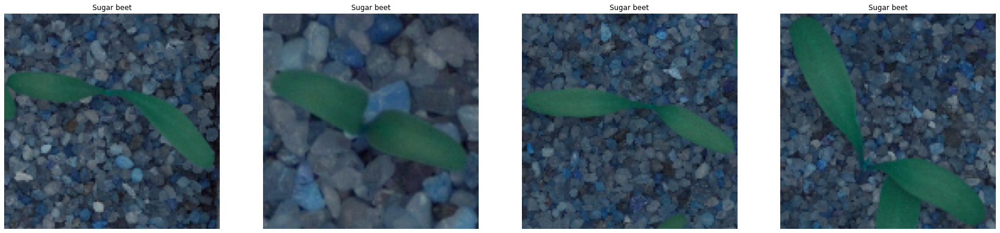

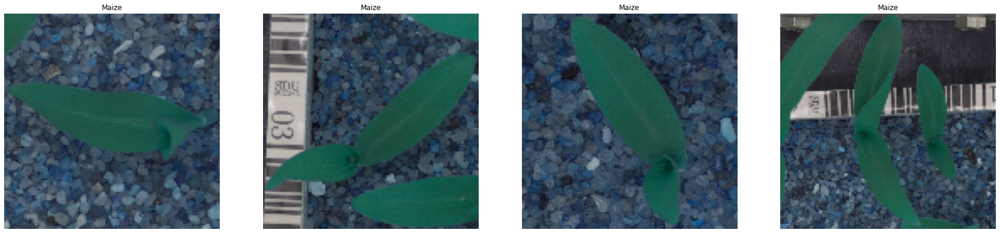

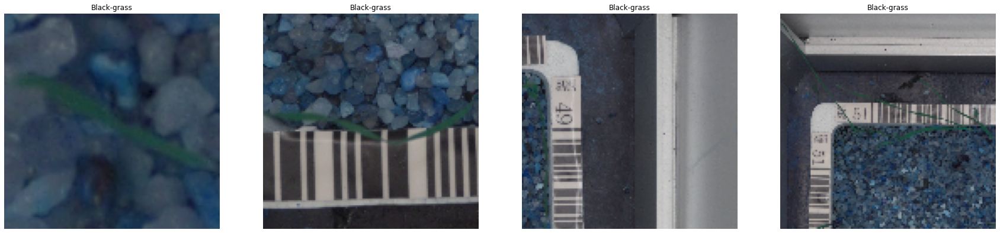

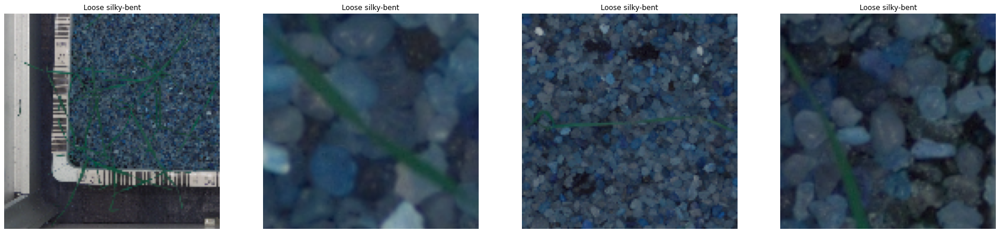

time: 7.77 s (started: 2022-02-09 12:35:25 +00:00)


In [17]:

# Plot every seed samples 
# plotting 12 x 6 image matrix
# Not using any colour map, want to see the image in its orignal color 

sample_limit_per_class=4

for seed_key in range(0, len(seed_types)):
    seed_name = seed_types[seed_key]
    seed_index_vals = seed_label_index[seed_key]
    select_plot_index = np.random.choice(seed_index_vals, sample_limit_per_class, replace = False)
    #print(f"seed_name : {seed_name}, seed_index_vals : {seed_index_vals}, select_plot_index : {select_plot_index}")
    fig, axs = plt.subplots(1, sample_limit_per_class, figsize=(30,10))
    for ax, img in zip(axs, select_plot_index):
       ax.imshow(data[img])
       ax.set_title(seed_name.capitalize())
       ax.grid(False)
       ax.axis('off')

plt.show()



**Observation**



*   We can clearly see its colour image 
*   We dont have only seed images we also have lot of noise in image in the form on measuring Tape or Bar code type



## Smoothing techniques on Images

* Blur imagess with various low pass filters
* Apply custom-made filters to images (2D convolution)


### Denoising techniques - Opencv library 


1.   Fast Nl Means Denoising Colored
2.   Gaussian Blur
3.   Median Blur
4.   Bilateral Filter



Seed Type : Small-flowered Cranesbill, at image index : [319] 


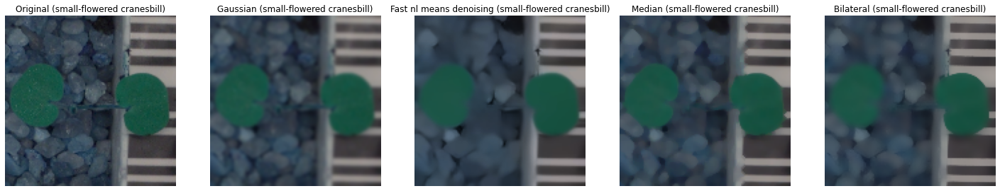

Seed Type : Fat Hen, at image index : [931] 


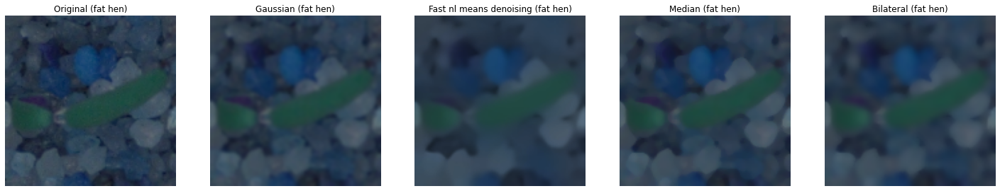

Seed Type : Shepherds Purse, at image index : [1007] 


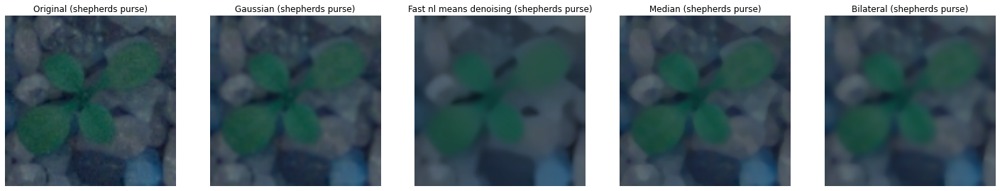

Seed Type : Common wheat, at image index : [1299] 


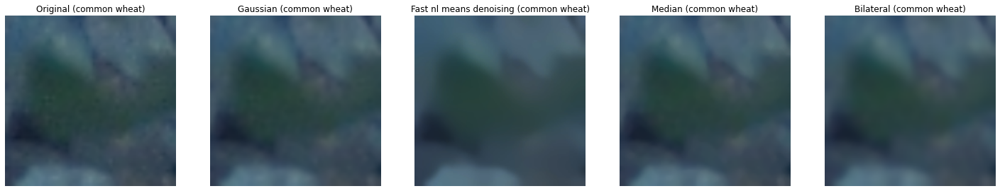

Seed Type : Common Chickweed, at image index : [1585] 


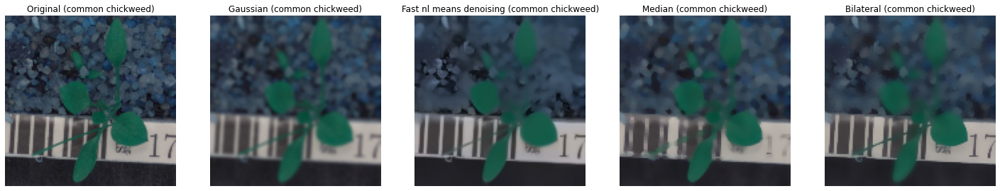

Seed Type : Charlock, at image index : [2260] 


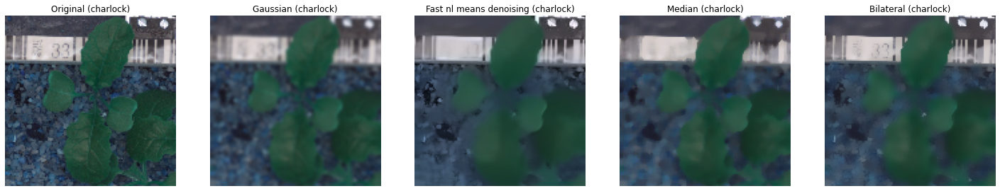

Seed Type : Cleavers, at image index : [2431] 


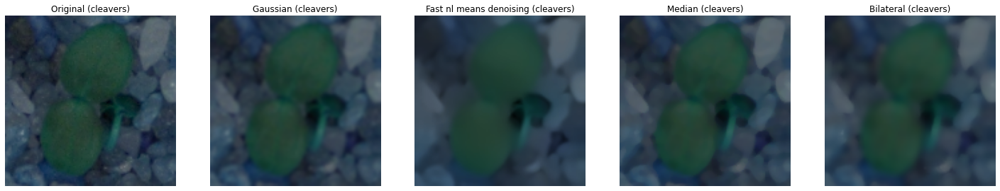

Seed Type : Scentless Mayweed, at image index : [2864] 


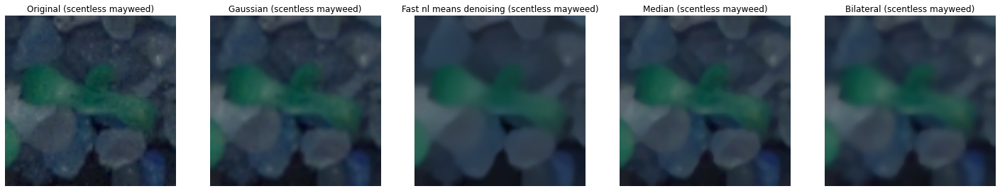

Seed Type : Sugar beet, at image index : [3426] 


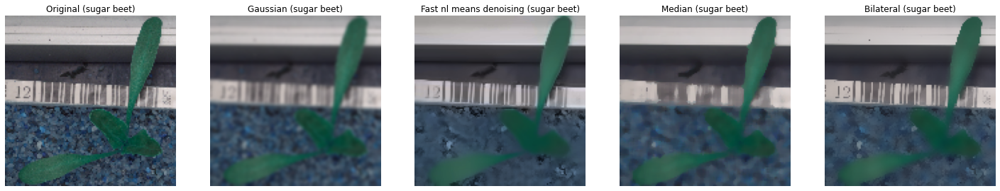

Seed Type : Maize, at image index : [3691] 


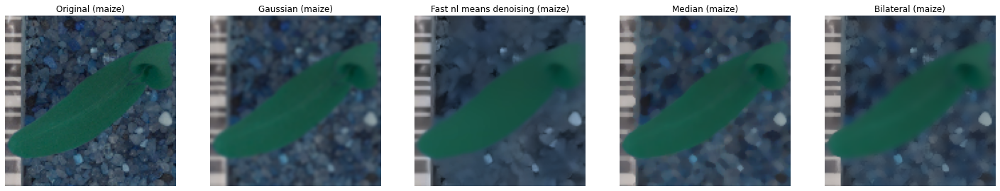

Seed Type : Black-grass, at image index : [3952] 


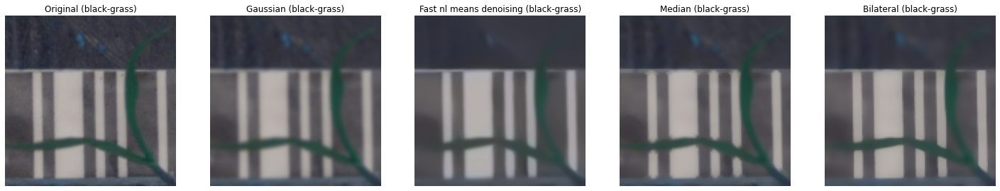

Seed Type : Loose Silky-bent, at image index : [4342] 


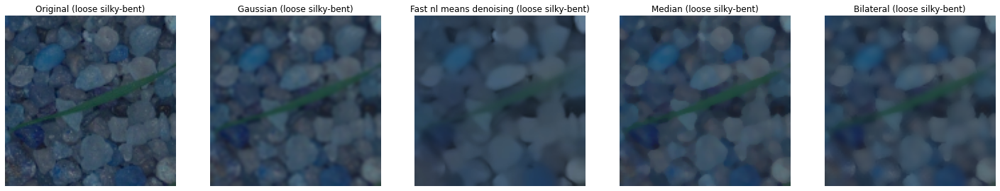

time: 7.04 s (started: 2022-02-09 12:35:33 +00:00)


In [18]:
# lets try different smoothing techniques on different seed type images

for seed_key in range(0, len(seed_types)):
    seed_name = seed_types[seed_key]
    seed_index_vals = seed_label_index[seed_key]
    select_plot_index = np.random.choice(seed_index_vals, 1, replace = False)
    print(f"Seed Type : {seed_name}, at image index : {select_plot_index} ")



    filtered_imgs_title = [];
    filtered_imgs=[]

    # Original Image 
    image = data[select_plot_index[0]]
    filtered_imgs_title.append(f"Original ({seed_name})")
    filtered_imgs.append(image)


    # Gaussian Filtering
    blur_img = cv2.GaussianBlur(image,(5,5),0)

    filtered_imgs_title.append(f"Gaussian ({seed_name})")
    filtered_imgs.append(blur_img)


    # fast Nl Means Denoising Colored Filtering
    dst_img = cv2.fastNlMeansDenoisingColored(image,None,10,10,7,21)

    filtered_imgs_title.append(f"Fast Nl Means Denoising ({seed_name})")
    filtered_imgs.append(dst_img)



    # Median Filtering
    median = cv2.medianBlur(image, 5)

    filtered_imgs_title.append(f"Median ({seed_name})")
    filtered_imgs.append(median)

    # Bilateral Filtering
    bilateral = cv2.bilateralFilter(image, 9, 75, 75)

    filtered_imgs_title.append(f"Bilateral ({seed_name})")
    filtered_imgs.append(bilateral)



    filtered_imgs = np.array(filtered_imgs)




    fig, axs = plt.subplots(1, len(filtered_imgs_title), figsize=(25,10))
    show_i=0;
    for ax, img_title in zip(axs, filtered_imgs_title):
        ax.imshow(filtered_imgs[show_i])
        ax.set_title(img_title.capitalize())
        ax.grid(False)
        ax.axis('off')
        show_i = show_i + 1
    plt.show()



### Crop Image with OpenCV

lets crop edges so we can remove some of the tape/barcode present in the image 



Shape of the original image shape : (128, 128, 3), lose 0 rows, cols
Shape of the 5% crop image shape : (120, 120, 3) lose 4 rows, cols
Shape of the 10% crop image shape : (112, 112, 3) lose 8 rows, cols
Shape of the 20% crop image shape : (96, 96, 3) lose 16 rows, cols
Seed Type : Small-flowered Cranesbill, at image index : [251] 


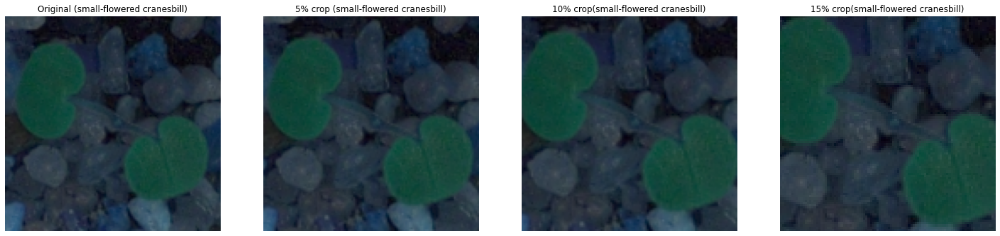

Seed Type : Fat Hen, at image index : [616] 


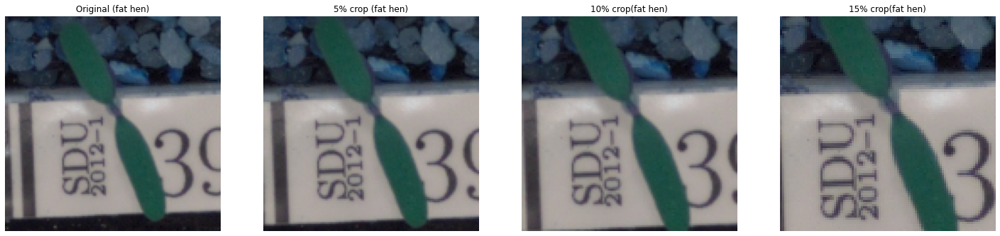

Seed Type : Shepherds Purse, at image index : [1045] 


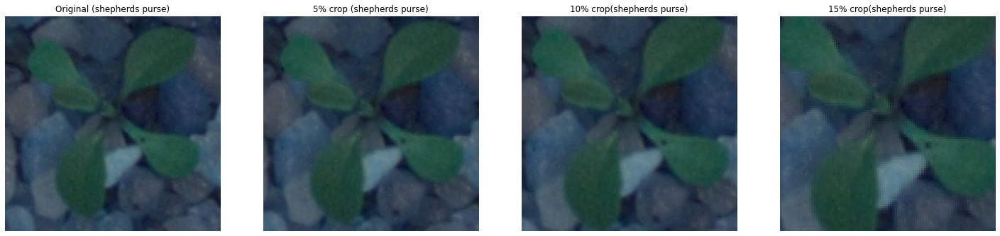

Seed Type : Common wheat, at image index : [1229] 


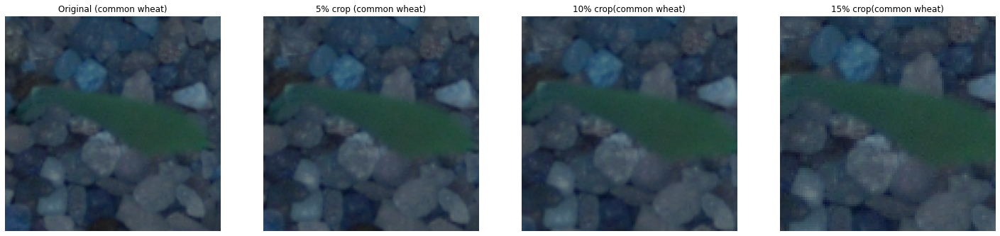

Seed Type : Common Chickweed, at image index : [1522] 


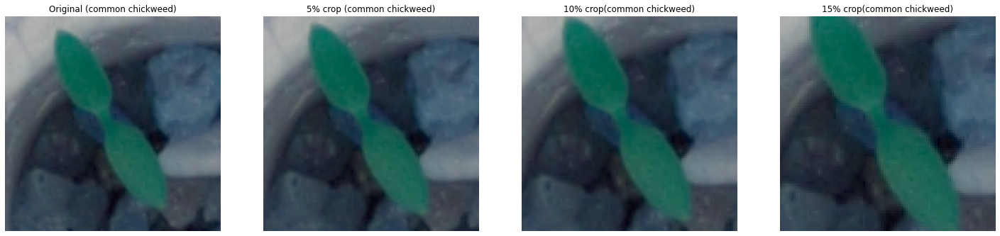

Seed Type : Charlock, at image index : [2035] 


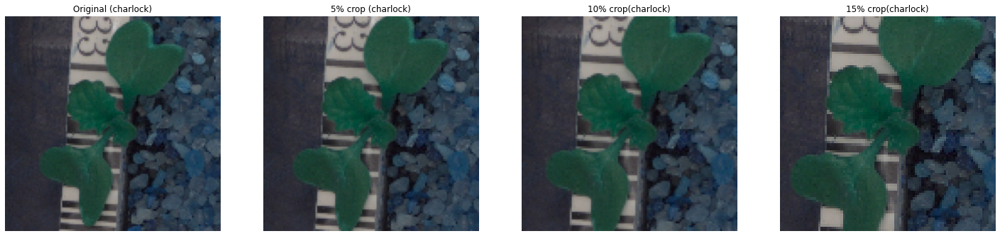

Seed Type : Cleavers, at image index : [2541] 


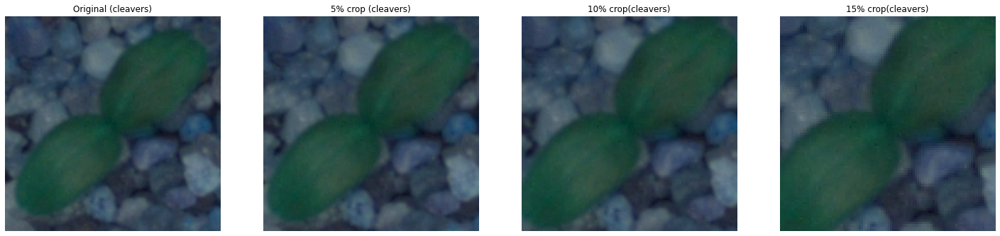

Seed Type : Scentless Mayweed, at image index : [3071] 


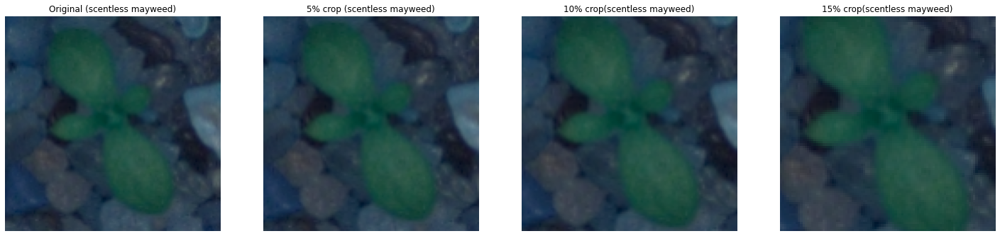

Seed Type : Sugar beet, at image index : [3512] 


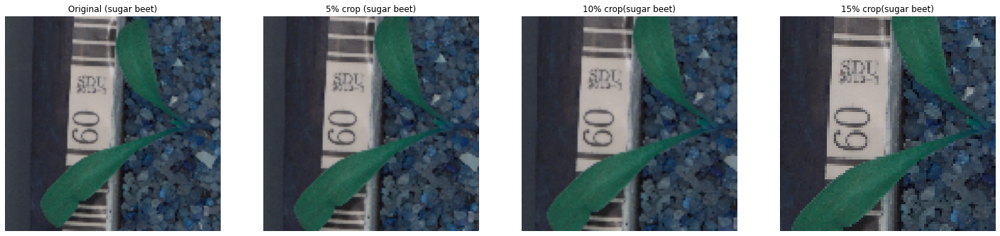

Seed Type : Maize, at image index : [3784] 


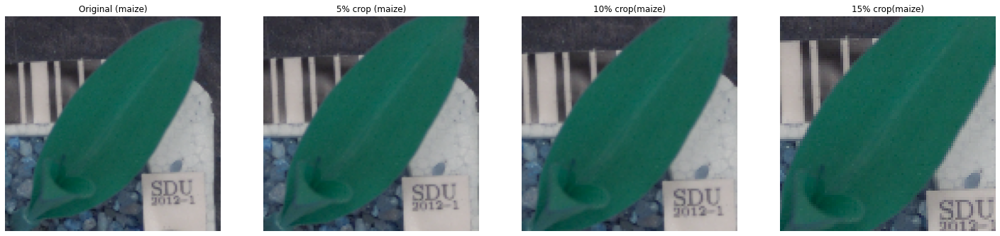

Seed Type : Black-grass, at image index : [4095] 


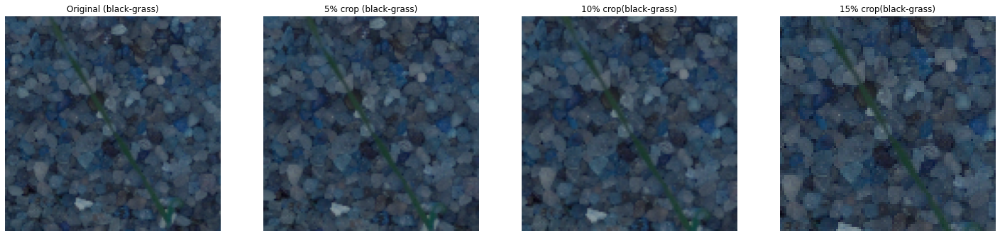

Seed Type : Loose Silky-bent, at image index : [4537] 


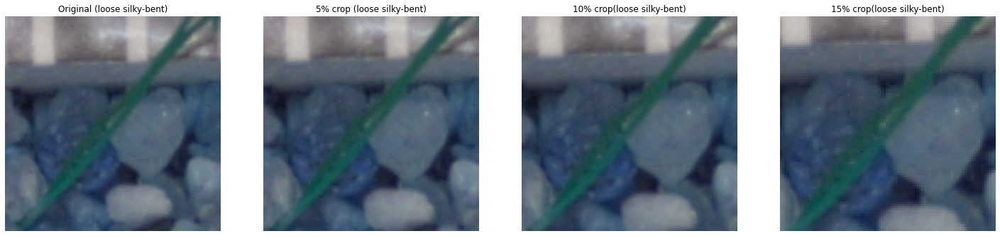

time: 5.34 s (started: 2022-02-09 12:35:40 +00:00)


In [19]:
# lets try different cropping like 5%, 10%, and 20%
image =  data[0]
image_size = data[0].shape[0]
five_crop = int(np.round((5 / image_size) * 100,0))
ten_crop=int(np.round((10 / image_size) * 100,0))
twenty_crop = int(np.round((20 / image_size) * 100,0))




# Check the shape of the input image & crop image
print(f"Shape of the original image shape : {image.shape}, lose 0 rows, cols")

crop_img = image[five_crop:image.shape[0]-five_crop, five_crop:image.shape[0]-five_crop]
print(f"Shape of the 5% crop image shape : {crop_img.shape} lose {five_crop} rows, cols")


crop_img = image[ten_crop:image.shape[0]-ten_crop, ten_crop:image.shape[0]-ten_crop]
print(f"Shape of the 10% crop image shape : {crop_img.shape} lose {ten_crop} rows, cols")

crop_img = image[twenty_crop:image.shape[0]-twenty_crop, twenty_crop:image.shape[0]-twenty_crop]
print(f"Shape of the 20% crop image shape : {crop_img.shape} lose {twenty_crop} rows, cols")



for seed_key in range(0, len(seed_types)):
    seed_name = seed_types[seed_key]
    seed_index_vals = seed_label_index[seed_key]
    select_plot_index = np.random.choice(seed_index_vals, 1, replace = False)
    print(f"Seed Type : {seed_name}, at image index : {select_plot_index} ")



    filtered_imgs_title = [];
    filtered_imgs=[]

    # Original Image 
    image = data[select_plot_index[0]]
    filtered_imgs_title.append(f"Original ({seed_name})")
    filtered_imgs.append(image)


    # 5% crop
    crop_img = image[five_crop:image.shape[0]-five_crop, five_crop:image.shape[0]-five_crop]

    filtered_imgs_title.append(f"5% crop ({seed_name})")
    filtered_imgs.append(crop_img)


    # 10% crop
    crop_img = image[ten_crop:image.shape[0]-ten_crop, ten_crop:image.shape[0]-ten_crop]

    filtered_imgs_title.append(f"10% crop({seed_name})")
    filtered_imgs.append(crop_img)



    # 15% crop
    crop_img = image[twenty_crop:image.shape[0]-twenty_crop, twenty_crop:image.shape[0]-twenty_crop]

    filtered_imgs_title.append(f"15% crop({seed_name})")
    filtered_imgs.append(crop_img)





    filtered_imgs = np.array(filtered_imgs)




    fig, axs = plt.subplots(1, len(filtered_imgs_title), figsize=(25,10))
    show_i=0;
    for ax, img_title in zip(axs, filtered_imgs_title):
        ax.imshow(filtered_imgs[show_i])
        ax.set_title(img_title.capitalize())
        ax.grid(False)
        ax.axis('off')
        show_i = show_i + 1
    plt.show()




**Crop Observations**

* Shape of the original image shape : (128, 128, 3), lose 0 rows, cols
* Shape of the 5% crop image shape : (120, 120, 3) lose 4 rows, cols
* Shape of the 10% crop image shape : (112, 112, 3) lose 8 rows, cols
* Shape of the 20% crop image shape : (96, 96, 3) lose 16 rows, cols

**lets do 5% edge crop to lose 5% edges so that image has maximum data and no data loss**

# Image Denoising & Convert to grayscale - Data Pre - Processing

## Converting image to grayscale to reduce the complexity and computation 

* Image Denoising with cv2.fastNlMeansDenoisingColored() - works with a color image.
*   Convert all RGB image to Gray Scale
*   Apply Gaussian Filtering to smoothen image


In [20]:
# Converting image to greyscale to reduce the complexity and computation 

#Images & Labels shape after converting to grayscale
print(f"Before Conversion Images shape : {data.shape}, And Labels shape : {data_labels.shape}, Data Type : {type(data)}")

data_grayscale_image_list =[]
data_filtered_image_list =[]
process_count = 0
for img in data:
    process_count=process_count+1

    if process_count%250==0: 
      print(f"Completed Image Processing count : {process_count}")
  

    # Crop Image

    image_size = img.shape[0]
    five_crop = int(np.round((5 / image_size) * 100,0))
    ten_crop=int(np.round((10 / image_size) * 100,0))
    twenty_crop = int(np.round((20 / image_size) * 100,0))

    crop_img = img[five_crop:image.shape[0]-five_crop, five_crop:image.shape[0]-five_crop].copy()

    # Gaussian Filtering & fastNlMeansDenoisingColored filter
    
    blur_img = cv2.fastNlMeansDenoisingColored(crop_img,None,10,10,7,21)
    blur_img = cv2.GaussianBlur(blur_img,(5,5),0)


    # Convert to GRAY Scale
    gray_img = cv2.cvtColor(blur_img, cv2.COLOR_BGR2GRAY) 
    #g_img = img


    data_grayscale_image_list.append(gray_img)
    data_filtered_image_list.append(blur_img)



data_grayscale_image = np.asarray(data_grayscale_image_list, dtype=np.int32)
data_filtered_image = np.asarray(data_filtered_image_list, dtype=np.int32)

print()

#Images & Labels shape after converting to grayscale
print(f"After Conversion to Gray Scale Images shape : {data_grayscale_image.shape}, And Labels shape : {data_labels.shape}, Data Type : {type(data_grayscale_image)}")
print(f"After Conversion to Gray Scale Images Image data Min value : {np.min(data_grayscale_image)}, Max Value : {np.max(data_grayscale_image)}")

print()

#Images & Labels shape after removal of unwanted noise 
print(f"After Noise Removal Images shape : {data_filtered_image.shape}, And Labels shape : {data_labels.shape}, Data Type : {type(data_filtered_image)}")
print(f"After Noise RemovalImages Image data Min value : {np.min(data_filtered_image)}, Max Value : {np.max(data_filtered_image)}")

Before Conversion Images shape : (4750, 128, 128, 3), And Labels shape : (4750, 1), Data Type : <class 'numpy.ndarray'>
Completed Image Processing count : 250
Completed Image Processing count : 500
Completed Image Processing count : 750
Completed Image Processing count : 1000
Completed Image Processing count : 1250
Completed Image Processing count : 1500
Completed Image Processing count : 1750
Completed Image Processing count : 2000
Completed Image Processing count : 2250
Completed Image Processing count : 2500
Completed Image Processing count : 2750
Completed Image Processing count : 3000
Completed Image Processing count : 3250
Completed Image Processing count : 3500
Completed Image Processing count : 3750
Completed Image Processing count : 4000
Completed Image Processing count : 4250
Completed Image Processing count : 4500
Completed Image Processing count : 4750

After Conversion to Gray Scale Images shape : (4750, 120, 120), And Labels shape : (4750, 1), Data Type : <class 'numpy.nd

### Post Data Preprocessing & Cleaning - Different Seed Class Images

**Let's visualize SEED images in RBG randomly from each of the 12 classes.**
**After Denoising**

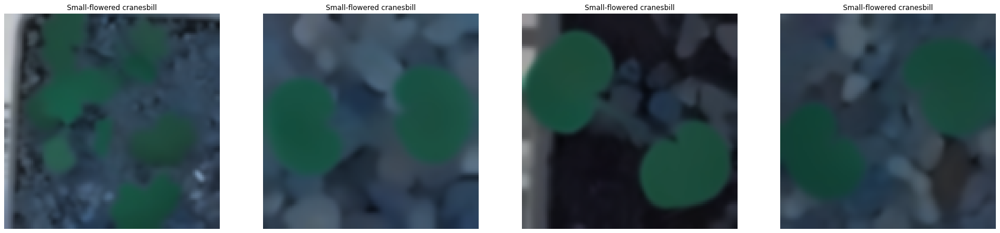

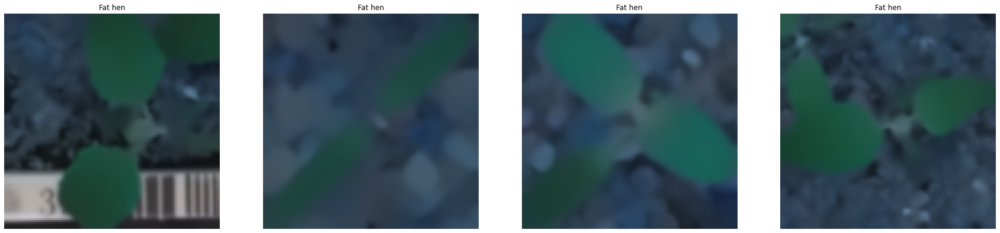

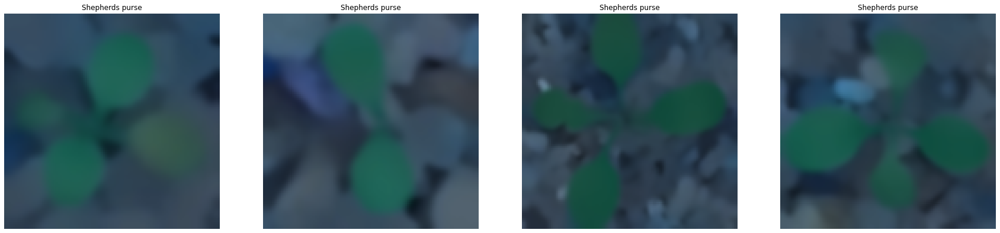

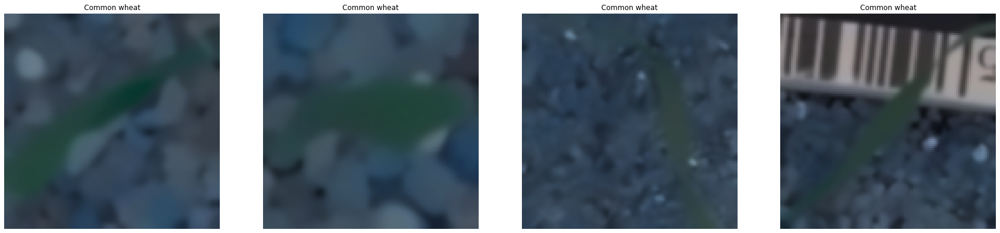

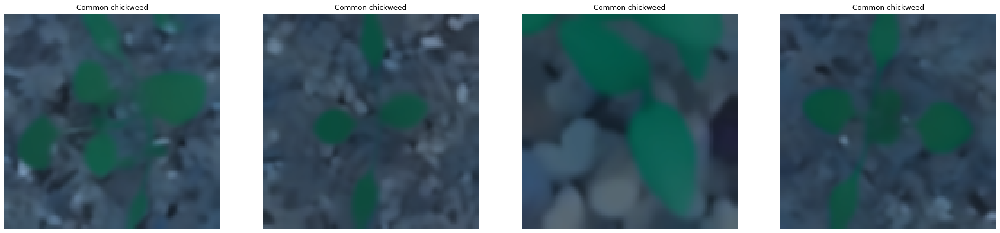

...

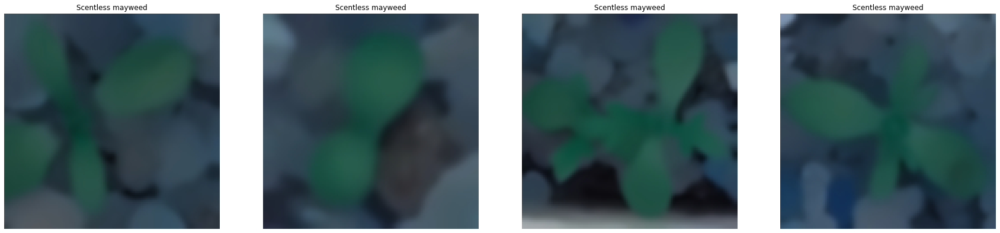

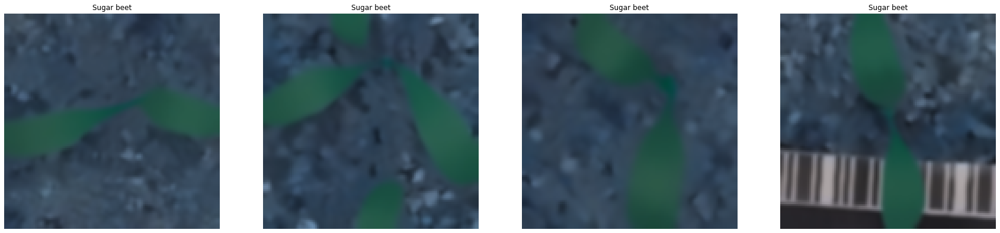

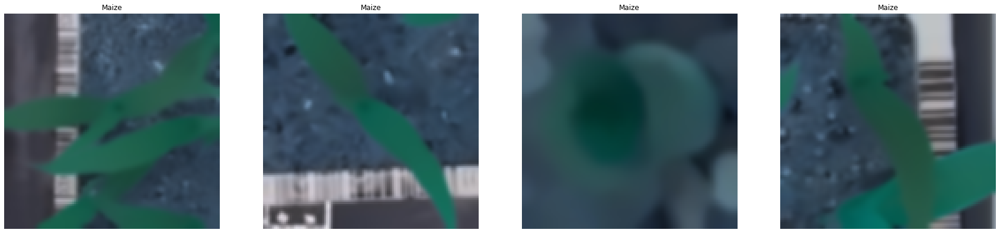

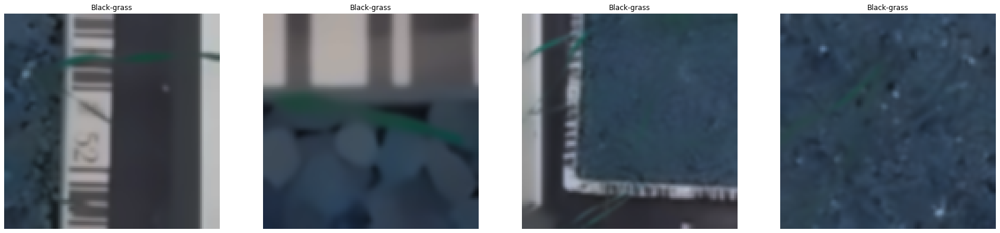

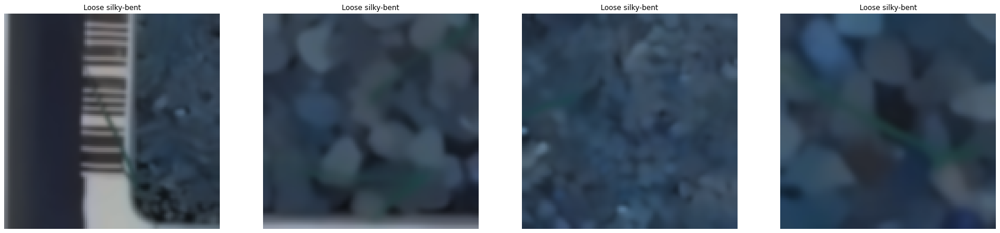

time: 3.62 s (started: 2022-02-09 12:43:17 +00:00)


In [21]:

# Plot every seed samples 
# plotting 12 x 6 image matrix
# Not using any colour map, want to see the image in its orignal color 


for seed_key in range(0, len(seed_types)):
    seed_name = seed_types[seed_key]
    seed_index_vals = seed_label_index[seed_key]
    select_plot_index = np.random.choice(seed_index_vals, sample_limit_per_class, replace = False)
    fig, axs = plt.subplots(1, sample_limit_per_class, figsize=(30,10))
    for ax, img in zip(axs, select_plot_index):
       ax.imshow(data_filtered_image[img])
       #ax.imshow(data_grayscale_image[img])
       ax.set_title(seed_name.capitalize())
       ax.grid(False)
       ax.axis('off')

plt.show()



We see that RGB dimensions are reduced to 1 dimension gray scale images

**Let's visualize SEED images in gray scale randomly from each of the 12 classes.**

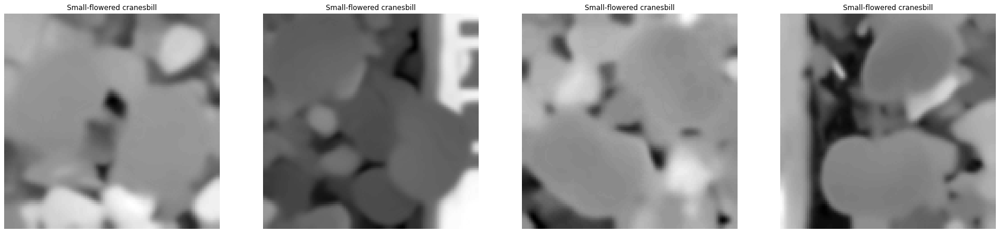

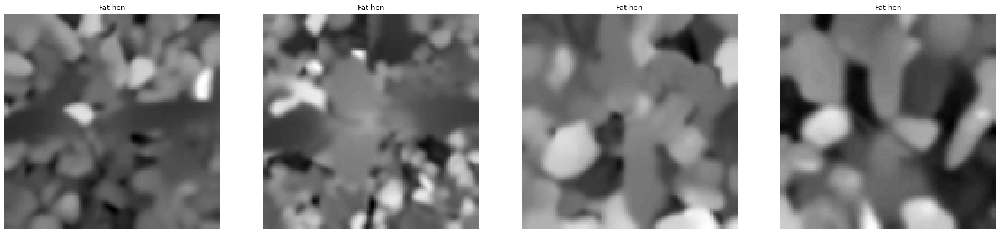

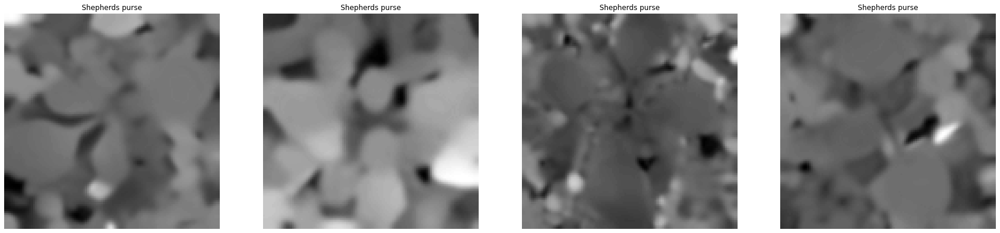

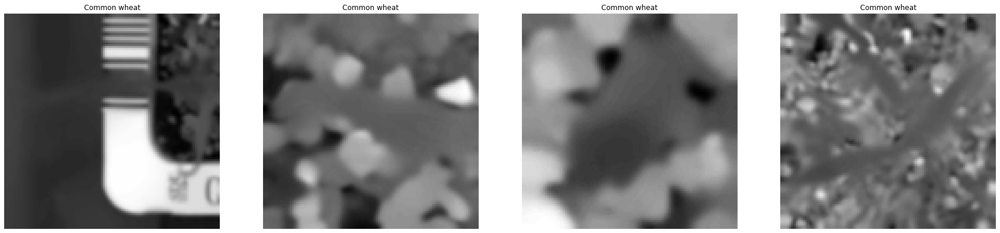

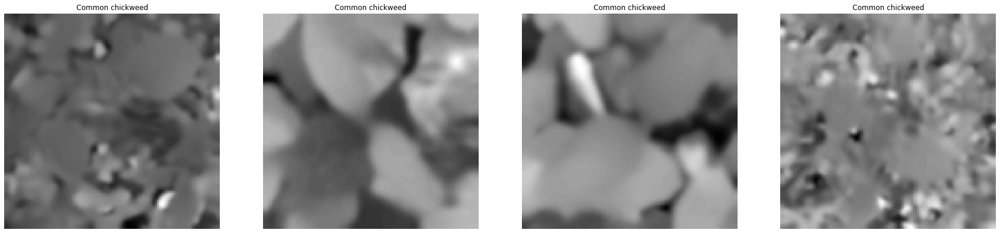

...

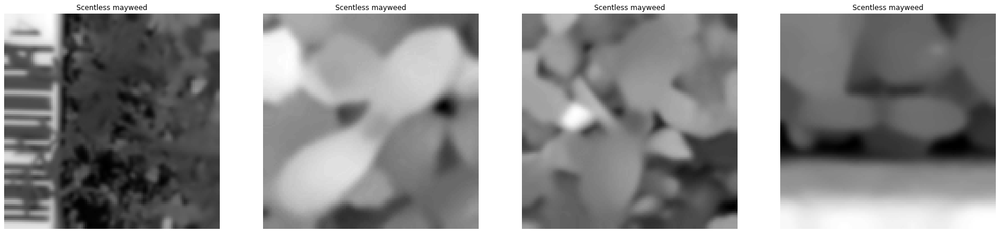

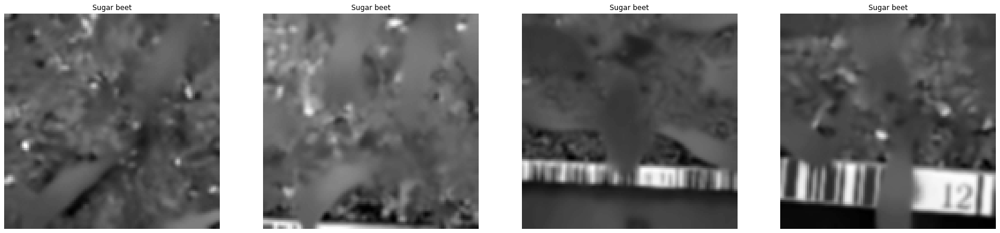

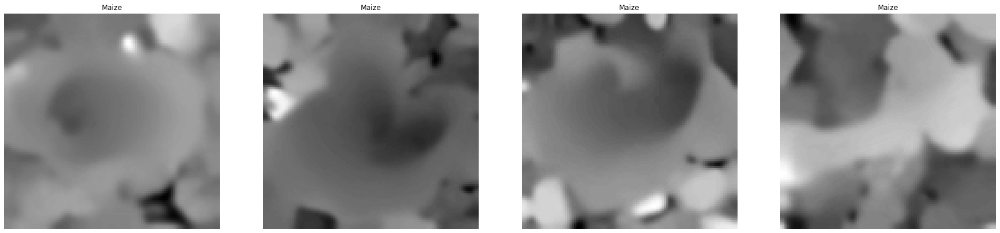

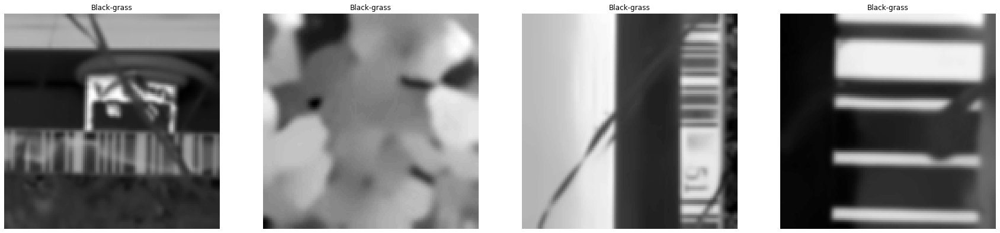

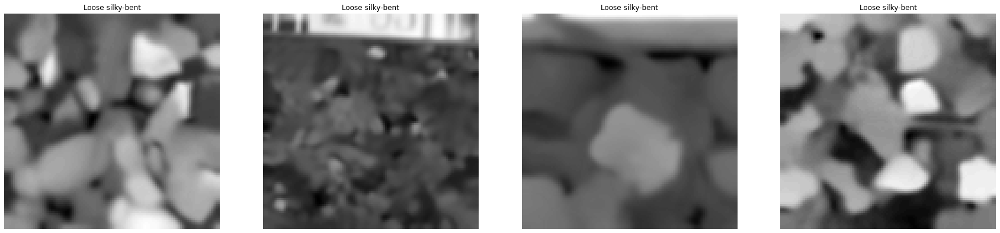

time: 3.62 s (started: 2022-02-09 12:43:20 +00:00)


In [22]:

# Plot every seed samples 
# plotting 12 x 6 image matrix


for seed_key in range(0, len(seed_types)):
    seed_name = seed_types[seed_key]
    seed_index_vals = seed_label_index[seed_key]
    select_plot_index = np.random.choice(seed_index_vals, sample_limit_per_class, replace = False)
    fig, axs = plt.subplots(1, sample_limit_per_class, figsize=(30,10))
    for ax, img in zip(axs, select_plot_index):
       ax.imshow(data_grayscale_image[img], cmap='gray')
       #ax.imshow(data_grayscale_image[img])
       ax.set_title(seed_name.capitalize())
       ax.grid(False)
       ax.axis('off')

plt.show()



**Observation**



*   We can clearly see its converted to greyscake image 
*   We dont have only seed images we also have lot of noise in image in the form on measuring Tape or Bar code type



## **Finding the mean image** for each seed class: 

In [23]:

# Calculate Mean image
def find_mean_img(full_mat, title, plot_num):
    # calculate the average

    mean_img = np.mean(full_mat, axis = 0,dtype=np.int32)
    print(f"Mean Image shape : {mean_img.shape}, for {title}")

    # reshape it back to a matrix
    mean_img = mean_img.reshape(full_mat[0].shape)


    plt.imshow(mean_img, cmap='gray')
    plt.title(f'Average {title}')
    plt.axis('off')
    plt.show()


time: 4.6 ms (started: 2022-02-09 12:43:24 +00:00)


## Finding the mean images - RGB 


Mean Image shape : (120, 120, 3), for Small-flowered Cranesbill


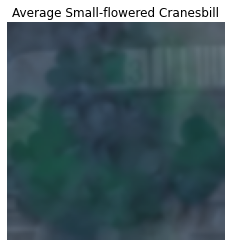


Mean Image shape : (120, 120, 3), for Fat Hen


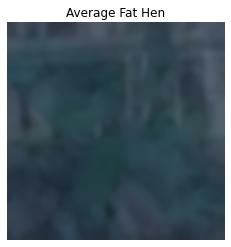


Mean Image shape : (120, 120, 3), for Shepherds Purse


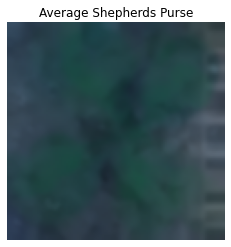


Mean Image shape : (120, 120, 3), for Common wheat


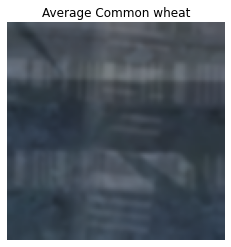


Mean Image shape : (120, 120, 3), for Common Chickweed


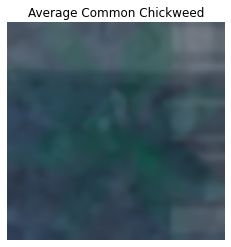


Mean Image shape : (120, 120, 3), for Charlock


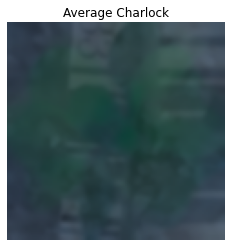


Mean Image shape : (120, 120, 3), for Cleavers


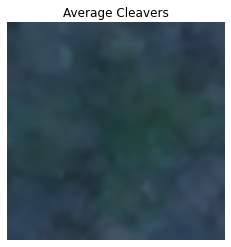


Mean Image shape : (120, 120, 3), for Scentless Mayweed


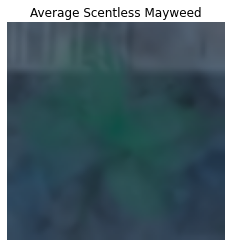


Mean Image shape : (120, 120, 3), for Sugar beet


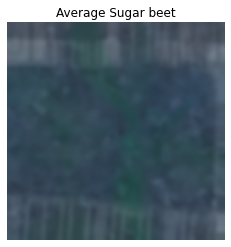


Mean Image shape : (120, 120, 3), for Maize


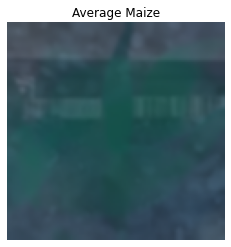


Mean Image shape : (120, 120, 3), for Black-grass


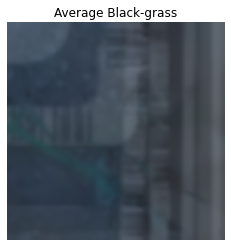


Mean Image shape : (120, 120, 3), for Loose Silky-bent


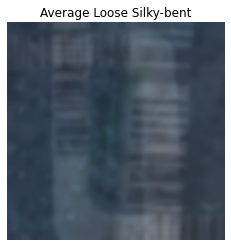

time: 1.13 s (started: 2022-02-09 12:43:24 +00:00)


In [24]:


# Show Mean image for all Seed Types

for seed_key in range(0, len(seed_types)):
    seed_name = seed_types[seed_key]
    seed_index_vals = seed_label_index[seed_key]
    print()
    # using first 20 images to plot mean image.
    find_mean_img(data_filtered_image[seed_index_vals[0:5]], seed_name, seed_key)






## Finding the mean image - Gray Scale


Mean Image shape : (120, 120), for Small-flowered Cranesbill


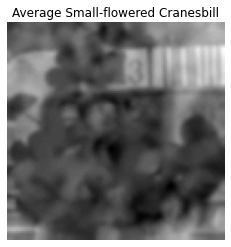


Mean Image shape : (120, 120), for Fat Hen


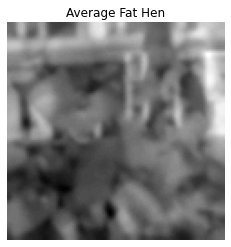


Mean Image shape : (120, 120), for Shepherds Purse


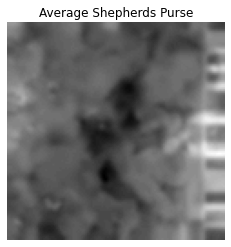


Mean Image shape : (120, 120), for Common wheat


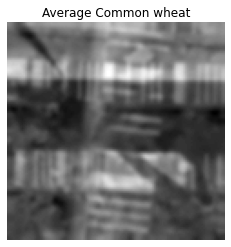


Mean Image shape : (120, 120), for Common Chickweed


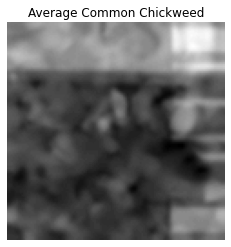


Mean Image shape : (120, 120), for Charlock


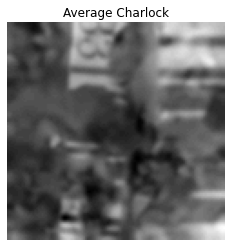


Mean Image shape : (120, 120), for Cleavers


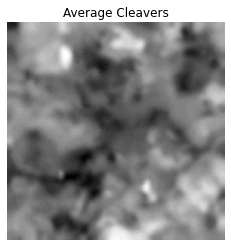


Mean Image shape : (120, 120), for Scentless Mayweed


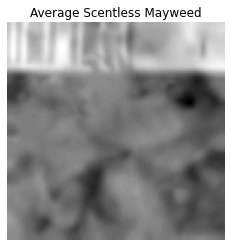


Mean Image shape : (120, 120), for Sugar beet


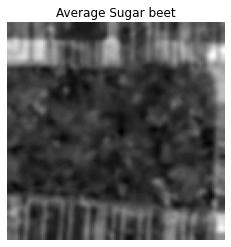


Mean Image shape : (120, 120), for Maize


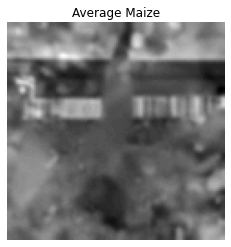


Mean Image shape : (120, 120), for Black-grass


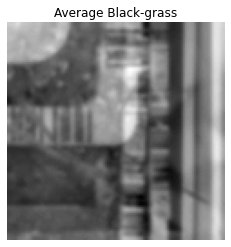


Mean Image shape : (120, 120), for Loose Silky-bent


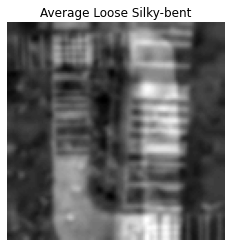

time: 830 ms (started: 2022-02-09 12:43:25 +00:00)


In [25]:


# Show Mean image for all Seed Types

for seed_key in range(0, len(seed_types)):
    seed_name = seed_types[seed_key]
    seed_index_vals = seed_label_index[seed_key]
    print()
    # using first 20 images to plot mean image.
    find_mean_img(data_grayscale_image[seed_index_vals[0:5]], seed_name, seed_key)






**We cannot see any seed in Mean images because of different image types and stones, bar code tapes**

## **Data Preprocessing** 

### Data Preparation for Modeling

* OneHot encoding for target type seed labels

* Data Standardization

### Normalize data - Make data compatible
- we must normalize our data as it is always required in neural network models
- we can achieve this by dividing the RGB codes with 255 (which is the maximum RGB code minus the minimum RGB code)
- normalize X_train and X_test
- make sure that the values are float so that we can get decimal points after division

In [26]:

# Image Height & Width 
img_ht_and_wd=data_filtered_image[0].shape[0]


# Add Images 

#X = data_grayscale_image.copy()

X = data_filtered_image.copy()

#X = data.copy()


# Adding Dependent Feature Seed Types

Y_Index = [(list(seed_types).index(item)) for item in data_labels["Label"]]

Y = pd.DataFrame(data=Y_Index, columns=["Label_Index"])



X = X.astype('float32')
# Normalizing pixel values  
X  = X /255.0  
# image reshaping 
X  = X.reshape(-1,img_ht_and_wd,img_ht_and_wd,3)


# Checking Shape of X & Y 
print(f"Shape of X: {X.shape}")
print()
print(f"After Data Standardization Image data Min value : {np.min(X)}, Max Value : {np.max(X)}")

Shape of X: (4750, 120, 120, 3)

After Data Standardization Image data Min value : 0.0, Max Value : 0.9960784316062927
time: 997 ms (started: 2022-02-09 12:43:26 +00:00)


### Splitting data into training and test

In [27]:
from sklearn.model_selection import train_test_split

# Splitting data into training and test set

X_train, X_test, y_train, y_test = train_test_split(
    X, Y, test_size=0.1, random_state=42, stratify=Y
)


# Checking Shape of X_train & X_test and Count of Exit Yes and No

print(f"Shape of X_train shape : {X_train.shape}, And X_test shape : {X_test.shape}")

print()
print("Target Values")

y_test.value_counts()

Shape of X_train shape : (4275, 120, 120, 3), And X_test shape : (475, 120, 120, 3)

Target Values


Label_Index
11             65
4              61
7              52
0              50
1              48
5              39
8              38
6              29
10             26
2              23
3              22
9              22
dtype: int64

time: 246 ms (started: 2022-02-09 12:43:27 +00:00)


### **One-Hot Encoding**

In [28]:

from tensorflow.keras.utils import to_categorical #to perform one-hot encoding 

encoded = to_categorical(np.array(y_train), num_classes=12, dtype='float32')
y_train_e=encoded

encoded_test = to_categorical(np.array(y_test))
y_test_e=encoded_test

print(f"Shape of y_train_e shape : {y_train_e.shape}, And y_test_e shape : {y_test_e.shape}")

Shape of y_train_e shape : (4275, 12), And y_test_e shape : (475, 12)
time: 3.47 ms (started: 2022-02-09 12:43:27 +00:00)


#  Insights based on EDA

* Total we have data for 12 different plant species.
* We have 4750 data image samples 
* Given images height & width are 128 * 128, Colour Images since it has 3 Dimensions for R, G & B 
*  We dont have only seed images we also have lot of noise in image in the form on measuring Tape or Bar code type
* Loose Silky-bent & Common Chickweed are most dominant with 14% and 13%.
* Maize are Common wheat & least dominant with 4.7% each

* No Missing data, No Outliers or Data Duplication

* Image Processing & Smoothing Filters 
 * Denoising images with Fast Nl Means Denoising Colored and Gaussian Blur
 * 5% edge crop to lose 5% edges so that image has maximum data and no data loss
 *  Convert all RGB image to Gray Scale
 *  **We cannot see any seed in Mean images because of different image types and stones, bar code tapes**
* Data Preprocessing
  * Split Data For Training & Testing, 90% data used to train the model since we dont have more data. And 10% used for testing
  * Encoding Done for Seed Lable to make data compatible for Tensorflow network Model
  * normalized data X_train and X_test  by dividing the RGB codes with 255 (which is the maximum RGB code minus the minimum RGB code)



# **Model Building** 



**Common methods used as callback to**
* log messages accuracy & loss after certain epoch
* early stop when accuracy not improving
* improving learning rates 

In [52]:

# Monitor Epochs and Log loss for every 50 

# print logs & scores 
class Metrics_Callback(tf.keras.callbacks.Callback):
  def __init__(self,x_val,y_val):
    self.x_val = x_val
    self.y_val = y_val
  def on_epoch_end(self, epoch, logs={}):
   if epoch % 5 ==0 :
      print(f"epoch ({epoch}) completed. Loss : {logs.get('loss')}, val_loss : {logs.get('val_loss')}. Accuracy : {logs.get('accuracy')}, val_accuracy : {logs.get('val_accuracy')}")
      print()

log_data = Metrics_Callback(X_test,y_test)   

# early stop 
early_stop_cb = tf.keras.callbacks.EarlyStopping(
    monitor='val_accuracy', patience=3, verbose=2, min_delta=0.0001,
    mode='max'
)

# Learning Rate Scheduler
# Reduce Learning Rate after certain epoch
def schedule(epoch,lr):
  if epoch % 25 == 0 and epoch>0:
    prev_lr=lr
    lr = lr - (lr*.25)
    print(f"Updating Learning Rate at epoch ({epoch}) from ({prev_lr}) to ({lr})");
    print()
    return lr
  return lr

# Decrease lr by 25% for every 20th epoch
lr_scheduler = tf.keras.callbacks.LearningRateScheduler(schedule,verbose=0)


time: 16.2 ms (started: 2022-02-09 13:00:16 +00:00)


In [53]:
#Plot Model Performance 

def plot_model_performance(history=None):
  
    hist  = pd.DataFrame(history.history)
    hist['epoch'] = history.epoch
    fig, axs = plt.subplots(1, 2, figsize=(20, 7))

    # Loss Metrics
    ax1 = axs
    ax1[0].set_title('Loss Graph')
    ax1[0].set_xlabel('epoch(s)')
    ax1[0].set_ylabel('loss')

    ax1[0].plot(hist['loss'])
    ax1[0].plot(hist['val_loss'])
    ax1[0].legend(("train" , "val") , loc =0)


    ax1[1].set_title('Accuracy Graph')
    ax1[1].set_xlabel('epoch(s)')
    ax1[1].set_ylabel('accuracy')

    ax1[1].plot(hist['accuracy'])
    ax1[1].plot(hist['val_accuracy'])
    ax1[1].legend(("train" , "val") , loc =0)


time: 10.4 ms (started: 2022-02-09 13:00:16 +00:00)


In [54]:
#Plot Model Scores

from sklearn.metrics import accuracy_score,recall_score,precision_score, f1_score,confusion_matrix

def plot_model_scores(model_input,history,X_train_in,X_test_in,y_train_in,y_test_in ):


    scores = model_input.evaluate(X_test, y_test_e)
    print()
    print(f"Total Epochs ran : {np.max(history.epoch)+1}, Model Loss : {scores[0]}, Model Accuracy : {scores[1]}")
    print()


    # Train Prediction 
    y_train_pred= model_input.predict(X_train_in)

    # Test Prediction 
    y_test_pred= model_input.predict(X_test_in)

    # Predictions

    y_train_pred_classes = np.argmax(y_train_pred, axis=1)
    y_test_pred_classes = np.argmax(y_test_pred, axis=1)

    train_score = np.round(accuracy_score(np.array(y_train_in), y_train_pred_classes) * 100, 2)
    test_score = np.round(accuracy_score(np.array(y_test_in), y_test_pred_classes) * 100, 2)

    train_score_recall = np.round(recall_score(np.array(y_train_in), y_train_pred_classes, average='weighted') * 100, 2)
    test_score_recall = np.round(recall_score(np.array(y_test_in), y_test_pred_classes, average='weighted') * 100, 2)

    train_score_pre = np.round(precision_score(np.array(y_train_in), y_train_pred_classes, average='weighted') * 100, 2)
    test_score_pre = np.round(precision_score(np.array(y_test_in), y_test_pred_classes, average='weighted') * 100, 2)


    train_score_f1 = np.round(f1_score(np.array(y_train_in), y_train_pred_classes, average='weighted') * 100, 2)
    test_score_f1 = np.round(f1_score(np.array(y_test_in), y_test_pred_classes, average='weighted') * 100, 2)

    train_df = pd.DataFrame(data=[["Training",y_train_in.shape[0],model_input.name,train_score,train_score_recall,train_score_pre,train_score_f1],
                                  ["Test",y_test_in.shape[0],model_input.name,test_score,test_score_recall,test_score_pre,test_score_f1]], 
                            columns=["Type", "# Records","Model","Accuracy","Recall","Precision","F1_score"])


    display(train_df)
    

    plot_model_performance(history)

    return train_df


time: 31.5 ms (started: 2022-02-09 13:00:16 +00:00)


In [55]:
#Plot Confusion Matrix
def plot_model_confusion_matrix(model_input, X_test_in, y_test_in):
    # Test Prediction 
    y_test_pred= model_input.predict(X_test_in)
    y_test_pred_classes = np.argmax(y_test_pred, axis=1)
    test_score = accuracy_score(np.array(y_test_in), y_test_pred_classes)
    cf_matrix = confusion_matrix(np.array(y_test_in), y_test_pred_classes)

    # Confusion matrix normalized per category true value
    #cf_matrix_n1 = np.round(cf_matrix/np.sum(cf_matrix, axis=1) * 100)
    #cf_matrix_n1 = cf_matrix/np.sum(cf_matrix, axis=1)

    group_counts = ["{0:0.0f}".format(value) for value in cf_matrix.flatten()]
    group_percentages = ["{0:.2%}".format(value) for value in cf_matrix.flatten()/np.sum(cf_matrix)]

    labels = [f"{v1}\n{v2}" for v1, v2 in zip(group_counts,group_percentages)]

    labels = np.asarray(labels).reshape(12,12)

    plt.figure(figsize=(20,15))
    sns.heatmap(cf_matrix, xticklabels=seed_types, yticklabels=seed_types, annot=labels, cmap='Blues',  fmt='')
    plt.title(f"Model : {model_input.name}, Accuracy : {np.round((test_score * 100),decimals=2)}%", fontsize = 20)
    plt.show()
  

time: 12 ms (started: 2022-02-09 13:00:16 +00:00)


# **Mode1 1**- **ANN** (Artificial Neural Network - fully connected)

### Build Model

In [56]:

# Build New Model 
model_ann = keras.Sequential([
            keras.layers.Flatten(input_shape=X[0].shape),
            keras.layers.Dense(500,kernel_initializer='he_uniform', activation=tf.nn.relu),
            keras.layers.Dense(700,kernel_initializer='he_uniform', activation=tf.nn.relu),
            keras.layers.Dense(len(seed_types), kernel_initializer='random_uniform',activation=tf.nn.softmax)
        ], name="ANN_Model_1")

# Compile Model 
model_ann.compile(loss='categorical_crossentropy', optimizer='adam', metrics=['accuracy'])




time: 58.2 ms (started: 2022-02-09 13:00:16 +00:00)


### Model Summary

In [126]:
model_ann.summary()

Model: "ANN_Model_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 flatten_4 (Flatten)         (None, 43200)             0         
                                                                 
 dense_12 (Dense)            (None, 500)               21600500  
                                                                 
 dense_13 (Dense)            (None, 700)               350700    
                                                                 
 dense_14 (Dense)            (None, 12)                8412      
                                                                 
Total params: 21,959,612
Trainable params: 21,959,612
Non-trainable params: 0
_________________________________________________________________
time: 3.88 ms (started: 2022-02-09 14:59:23 +00:00)


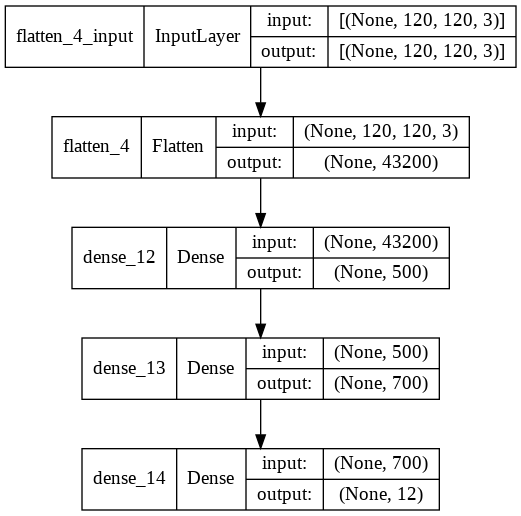

time: 480 ms (started: 2022-02-09 14:59:24 +00:00)


In [127]:
#plot model summary 
from tensorflow.keras.utils import plot_model
plot_model(model=model_ann, show_shapes=True)

### Train Model

In [58]:
#Train the model

hist=model_ann.fit(X_train, 
          y_train_e, #It expects integers because of the sparse_categorical_crossentropy loss function
          epochs=200, #number of iterations over the entire dataset to train on
          batch_size=500,validation_split=0.1, verbose=0,callbacks=[log_data,early_stop_cb, lr_scheduler],use_multiprocessing=True,shuffle=True) #number of samples per gradient update for training

epoch (0) completed. Loss : 20.445663452148438, val_loss : 14.375910758972168. Accuracy : 0.10605666786432266, val_accuracy : 0.10280373692512512

epoch (5) completed. Loss : 2.352423906326294, val_loss : 2.32867693901062. Accuracy : 0.19573694467544556, val_accuracy : 0.2429906576871872

epoch (10) completed. Loss : 2.0696089267730713, val_loss : 2.1066057682037354. Accuracy : 0.2783987522125244, val_accuracy : 0.2616822421550751

epoch (15) completed. Loss : 1.8186125755310059, val_loss : 1.88148033618927. Accuracy : 0.3886145055294037, val_accuracy : 0.34813085198402405

Epoch 00018: early stopping
time: 14.4 s (started: 2022-02-09 13:00:16 +00:00)


## Model Performance Evaluation
### Model Loss, Accuracy, Recall & Other Scores 

15/15 [==============================] - 0s 7ms/step - loss: 1.7973 - accuracy: 0.3474

Total Epochs ran : 18, Model Loss : 1.7973206043243408, Model Accuracy : 0.34736841917037964



,Type,# Records,Model,Accuracy,Recall,Precision,F1_score
0,Training,4275,ANN_Model_1,37.64,37.64,40.67,28.16
1,Test,475,ANN_Model_1,34.74,34.74,32.88,26.11


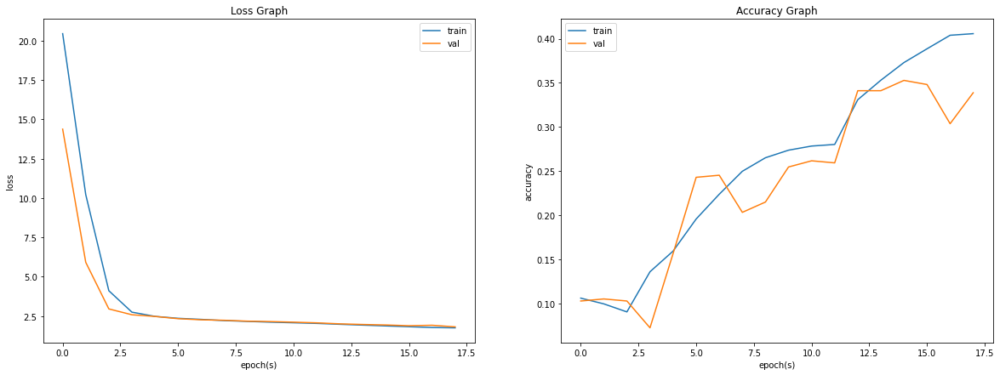

time: 2.04 s (started: 2022-02-09 13:00:30 +00:00)


In [59]:
# Show model performance & scores 

model1_result = plot_model_scores(model_input=model_ann, history=hist, X_train_in=X_train, X_test_in=X_test, y_train_in=y_train, y_test_in=y_test)
                  

### **Plotting the confusion matrix for the model** 


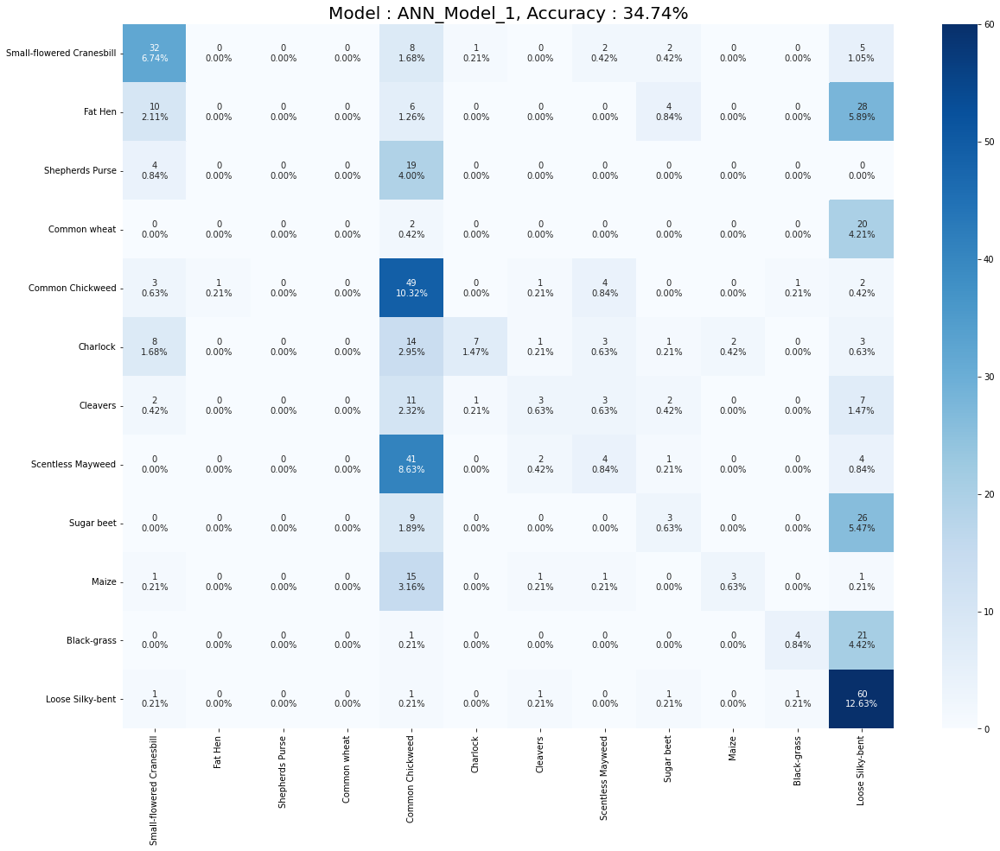

time: 1.11 s (started: 2022-02-09 13:00:32 +00:00)


In [60]:
# Show Confustion matrix for test data 

plot_model_confusion_matrix(model_input=model_ann, X_test_in=X_test, y_test_in=y_test)

In [61]:
# Model Scores

display(model1_result)

,Type,# Records,Model,Accuracy,Recall,Precision,F1_score
0,Training,4275,ANN_Model_1,37.64,37.64,40.67,28.16
1,Test,475,ANN_Model_1,34.74,34.74,32.88,26.11


time: 9.58 ms (started: 2022-02-09 13:00:33 +00:00)


### **Model Observation**

* Poor Accuracy Scores - **Test Accuracy Score : 35%**
* Modes does not overfit. But scores are poor
* Model has **22 Million Trainable params** 
* Model Only identifies correctly Loose Silky-bent, Common Chickweed, Small-flowered Cranesbill. Missing all other 9 types 



As we see here, the **ANN does not show a good test accuracy**, since ANNs are unable to capture spatial correlation characteristics of the image. 

**Let's try Convolutional Neural Networks, which take in the whole image as a 2D matrix instead.** 
CNNs tend to behave well on image data but the important point to consider is, it may not be true until an optimized CNN is built depending on the data.

# Model 2 - **Convolutional Neural Network (CNN)**

Lets try a CNN model  with Dropout

* Model with 1 Convolutional Layer & Filters with dropout 
* 2 Dense Layers with dropout

### Build Model

In [62]:


# Build New Model 
model_cnn_1 = Sequential(name="CNN_Model_2")

# Add Convolutional Layer & Filters

model_cnn_1.add(Conv2D(16, (5,5), activation='relu', input_shape=X[0].shape))
model_cnn_1.add(MaxPooling2D(2,2))
model_cnn_1.add(Dropout(0.25))

# Dense Layers 


model_cnn_1.add(Flatten())
model_cnn_1.add(Dense(1024,kernel_initializer='he_uniform', activation='relu'))
model_cnn_1.add(Dropout(0.5))
model_cnn_1.add(Dense(512,kernel_initializer='he_uniform', activation='relu'))

#Output Layer 
# The final output layer with 12 neurons to predict the categorical classifcation
model_cnn_1.add(Dense(units = len(seed_types), kernel_initializer='random_uniform', activation = 'softmax'))


# Adam Optimizer with low learning rate 

optimizer = Adam(lr=0.001, beta_1=0.9, beta_2=0.999)


# Compile Model 
model_cnn_1.compile(optimizer = optimizer , loss = "categorical_crossentropy", metrics=["accuracy"])




time: 106 ms (started: 2022-02-09 13:00:33 +00:00)


### Model Summary

In [63]:
model_cnn_1.summary()

Model: "CNN_Model_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_5 (Conv2D)           (None, 116, 116, 16)      1216      
                                                                 
 max_pooling2d_5 (MaxPooling  (None, 58, 58, 16)       0         
 2D)                                                             
                                                                 
 dropout_8 (Dropout)         (None, 58, 58, 16)        0         
                                                                 
 flatten_5 (Flatten)         (None, 53824)             0         
                                                                 
 dense_15 (Dense)            (None, 1024)              55116800  
                                                                 
 dropout_9 (Dropout)         (None, 1024)              0         
                                                       

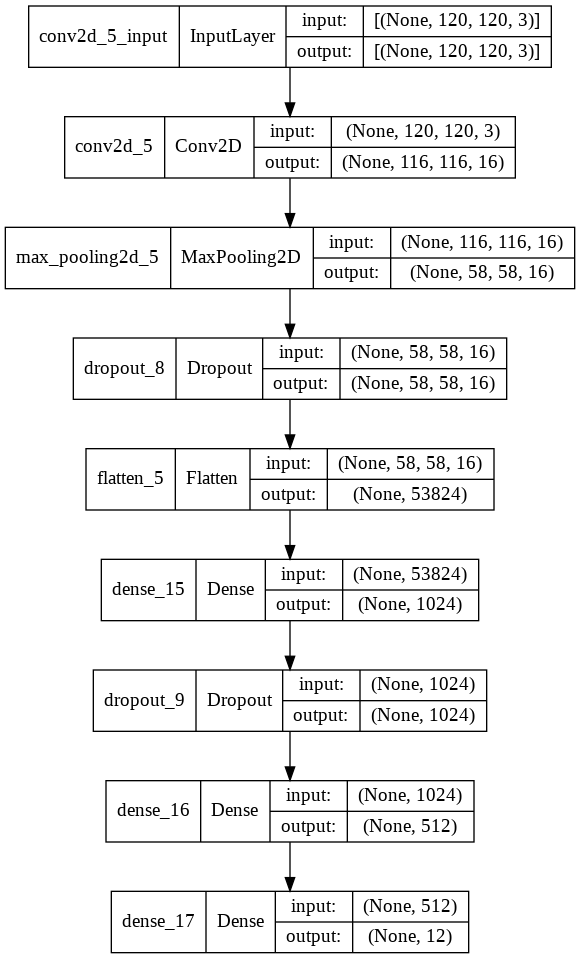

time: 506 ms (started: 2022-02-09 14:58:58 +00:00)


In [125]:
#plot model summary 
from tensorflow.keras.utils import plot_model
plot_model(model=model_cnn_1, show_shapes=True)

### Train Model

In [64]:
#Train the model

hist=model_cnn_1.fit(X_train, 
          y_train_e, #It expects integers because of the sparse_categorical_crossentropy loss function
          epochs=200, #number of iterations over the entire dataset to train on
          batch_size=500,validation_split=0.1, verbose=0,callbacks=[log_data,early_stop_cb, lr_scheduler],use_multiprocessing=True,shuffle=True) #number of samples per gradient update for training

epoch (0) completed. Loss : 8.750195503234863, val_loss : 3.030238151550293. Accuracy : 0.09877827018499374, val_accuracy : 0.0677570104598999

epoch (5) completed. Loss : 2.4041659832000732, val_loss : 2.407008647918701. Accuracy : 0.15414609014987946, val_accuracy : 0.17757008969783783

epoch (10) completed. Loss : 2.107795476913452, val_loss : 2.0146660804748535. Accuracy : 0.25994279980659485, val_accuracy : 0.322429895401001

epoch (15) completed. Loss : 1.7863924503326416, val_loss : 1.7000519037246704. Accuracy : 0.3823758661746979, val_accuracy : 0.4252336323261261

epoch (20) completed. Loss : 1.6547279357910156, val_loss : 1.5017869472503662. Accuracy : 0.414348840713501, val_accuracy : 0.492990642786026

Epoch 00025: early stopping
time: 2min 16s (started: 2022-02-09 13:00:34 +00:00)


## Model Performance Evaluation
### Model Loss, Accuracy, Recall & Other Scores 

15/15 [==============================] - 0s 17ms/step - loss: 1.5013 - accuracy: 0.4905

Total Epochs ran : 25, Model Loss : 1.5012909173965454, Model Accuracy : 0.49052631855010986



,Type,# Records,Model,Accuracy,Recall,Precision,F1_score
0,Training,4275,CNN_Model_2,51.74,51.74,54.55,47.13
1,Test,475,CNN_Model_2,49.05,49.05,47.14,44.15


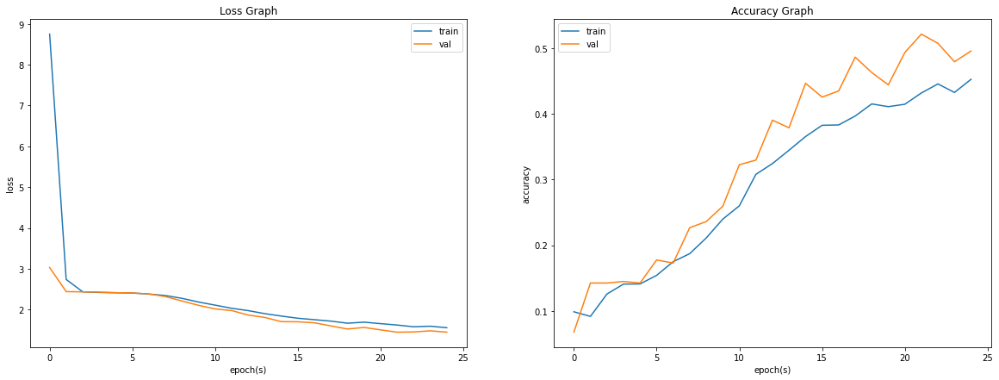

time: 3.33 s (started: 2022-02-09 13:02:50 +00:00)


In [65]:
# Show model performance & scores 

model2_result = plot_model_scores(model_input=model_cnn_1, history=hist, X_train_in=X_train, X_test_in=X_test, y_train_in=y_train, y_test_in=y_test)
                  

### **Plotting the confusion matrix for the model** 


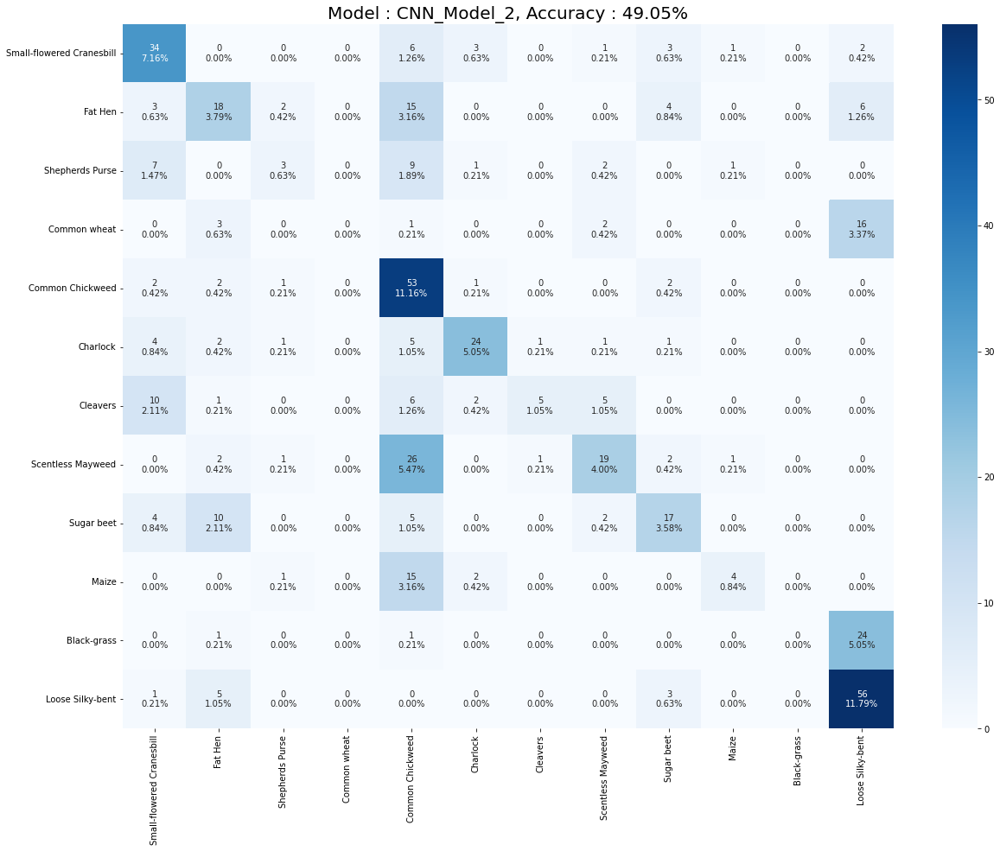

time: 1.21 s (started: 2022-02-09 13:02:54 +00:00)


In [66]:
# Show Confustion matrix for test data 

plot_model_confusion_matrix(model_input=model_cnn_1, X_test_in=X_test, y_test_in=y_test)

In [67]:
# Model Scores

display(model2_result)

,Type,# Records,Model,Accuracy,Recall,Precision,F1_score
0,Training,4275,CNN_Model_2,51.74,51.74,54.55,47.13
1,Test,475,CNN_Model_2,49.05,49.05,47.14,44.15


time: 9.74 ms (started: 2022-02-09 13:02:55 +00:00)


### **Model Observation**


* Average Accuracy Scores - **Test Accuracy Score : 49%**
* Modes does not overfit. But scores are poor
* Model has **55.6 Million Trainable params** 
* Model not able to indentify Common Wheat, Charlock, Maize, Black-grass, Shepherds Purse


Here we can observe that this is performing better than ANN but we will try to optimize this model and improve its performance.

This model unfortunately **does not have a good test accuracy** 


# Model 3 - **Convolutional Neural Network (CNN)**

Since CNN Model 1 does not appear to have good test accuracy and appears to be overfitting on the training dataset, let's build new CNN Model 2, which has a different architecture that should generalize well and not overfit.

## Model Performance Improvement
Lets try a CNN model with multiple Convolutional layers, Dropout and multiple Dense Layers 

* Model with multiple Convolutional Layer & Filters with dropouts
* Multiple Dense Layers with dropouts
* Low Learning Rate 


### Build Model

In [188]:


# Build New Model 
model_cnn_3 = Sequential(name="CNN_Model_3")

# Add Convolutional Layer & Filters
# Add a Convolution layer with 32 kernels of 5X5 shape with activation function ReLU
model_cnn_3.add(Conv2D(32, (3, 3), input_shape = X[0].shape, activation = 'relu', padding = 'same'))

# Add a Max Pooling layer of size 2X2
model_cnn_3.add(MaxPooling2D(pool_size = (2, 2)))

#Add Dropout
model_cnn_3.add(Dropout(0.25))




# Add another Convolution layer with 32 kernels of 3X3 shape with activation function ReLU
model_cnn_3.add(Conv2D(32, (5, 5), activation = 'relu', padding = 'same'))

# Adding another pooling layer
model_cnn_3.add(MaxPooling2D(pool_size = (2, 2)))

#Add another Dropout
model_cnn_3.add(Dropout(0.25))

# Add another Convolution layer with 32 kernels of 3X3 shape with activation function ReLU
model_cnn_3.add(Conv2D(32, (3, 3), activation = 'relu', padding = 'same'))

# Adding another pooling layer
model_cnn_3.add(MaxPooling2D(pool_size = (2, 2)))

#Add another Dropout
model_cnn_3.add(Dropout(0.25))




# Dense Layers 

# Flattening the layer before fully connected layers
model_cnn_3.add(Flatten())

# Adding a fully connected layer with 512 neurons
model_cnn_3.add(Dense(units = 512, activation= 'relu'))

#Add another Dropout
model_cnn_3.add(Dropout(0.50))


# Adding a fully connected layer with 128 neurons
model_cnn_3.add(Dense(units = 128, activation = 'relu'))


#Output Layer 
# The final output layer with 12 neurons to predict the categorical classifcation
model_cnn_3.add(Dense(units = len(seed_types), kernel_initializer='random_uniform', activation = 'softmax'))


# Adam Optimizer with low learning rate 

optimizer = Adam(lr=0.0001, beta_1=0.9, beta_2=0.999)


# Compile Model 
model_cnn_3.compile(optimizer = optimizer , loss = "categorical_crossentropy", metrics=["accuracy"])




time: 134 ms (started: 2022-02-09 16:26:17 +00:00)


### Model Summary

In [189]:
model_cnn_3.summary()

Model: "CNN_Model_3"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_47 (Conv2D)          (None, 120, 120, 32)      896       
                                                                 
 max_pooling2d_47 (MaxPoolin  (None, 60, 60, 32)       0         
 g2D)                                                            
                                                                 
 dropout_79 (Dropout)        (None, 60, 60, 32)        0         
                                                                 
 conv2d_48 (Conv2D)          (None, 60, 60, 32)        25632     
                                                                 
 max_pooling2d_48 (MaxPoolin  (None, 30, 30, 32)       0         
 g2D)                                                            
                                                                 
 dropout_80 (Dropout)        (None, 30, 30, 32)        

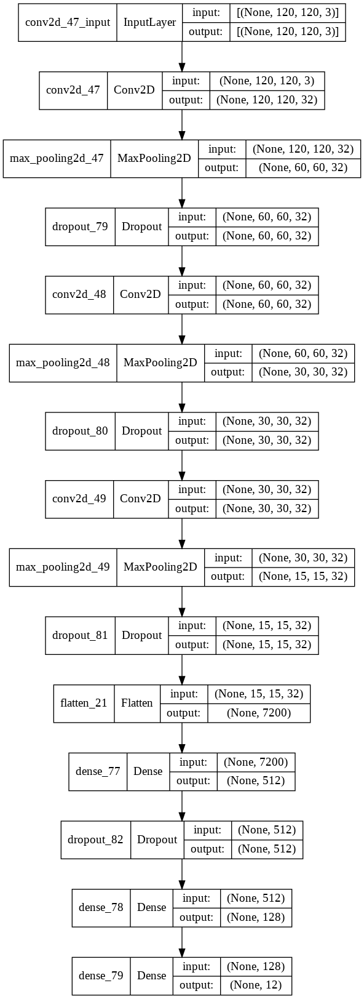

time: 572 ms (started: 2022-02-09 16:26:17 +00:00)


In [190]:
#plot model summary 
from tensorflow.keras.utils import plot_model
plot_model(model=model_cnn_3, show_shapes=True)

### Train Model

In [191]:
#Train the model

hist=model_cnn_3.fit(X_train, 
          y_train_e, #It expects integers because of the sparse_categorical_crossentropy loss function
          epochs=200, #number of iterations over the entire dataset to train on
          validation_split=0.1, verbose=0,callbacks=[log_data,early_stop_cb, lr_scheduler],use_multiprocessing=True,shuffle=True) #number of samples per gradient update for training

epoch (0) completed. Loss : 2.42667555809021, val_loss : 2.4437034130096436. Accuracy : 0.1408890038728714, val_accuracy : 0.1425233632326126

epoch (5) completed. Loss : 1.3691285848617554, val_loss : 1.3976250886917114. Accuracy : 0.5170262455940247, val_accuracy : 0.5560747385025024

epoch (10) completed. Loss : 0.9463712573051453, val_loss : 0.9570969343185425. Accuracy : 0.6724720597267151, val_accuracy : 0.6658878326416016

epoch (15) completed. Loss : 0.7469142079353333, val_loss : 0.8490699529647827. Accuracy : 0.7512347102165222, val_accuracy : 0.6915887594223022

epoch (20) completed. Loss : 0.6192763447761536, val_loss : 0.7521336674690247. Accuracy : 0.778788685798645, val_accuracy : 0.7289719581604004

Epoch 00021: early stopping
time: 7min 55s (started: 2022-02-09 16:26:18 +00:00)


## Model Performance Evaluation
### Model Loss, Accuracy, Recall & Other Scores 

15/15 [==============================] - 0s 24ms/step - loss: 0.7775 - accuracy: 0.7516

Total Epochs ran : 21, Model Loss : 0.7774999737739563, Model Accuracy : 0.7515789270401001



,Type,# Records,Model,Accuracy,Recall,Precision,F1_score
0,Training,4275,CNN_Model_3,82.41,82.41,82.12,81.20
1,Test,475,CNN_Model_3,75.16,75.16,77.01,73.64


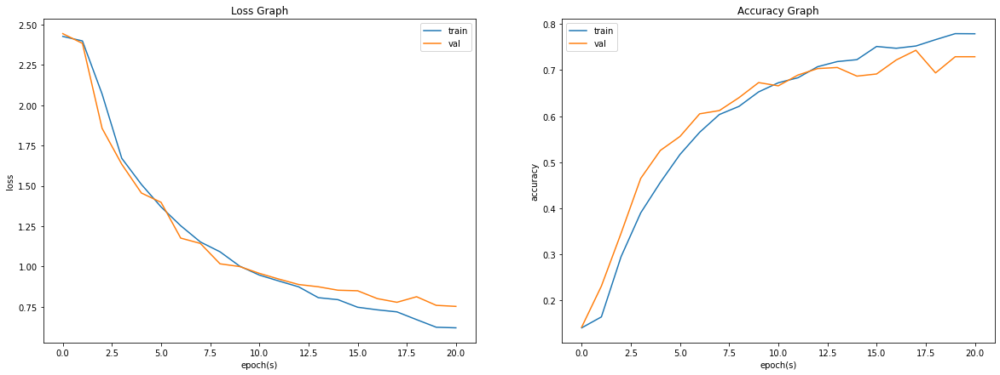

time: 4.64 s (started: 2022-02-09 16:34:14 +00:00)


In [192]:
# Show model performance & scores 

model3_result = plot_model_scores(model_input=model_cnn_3, history=hist, X_train_in=X_train, X_test_in=X_test, y_train_in=y_train, y_test_in=y_test)
                  

### **Plotting the confusion matrix for the model** 


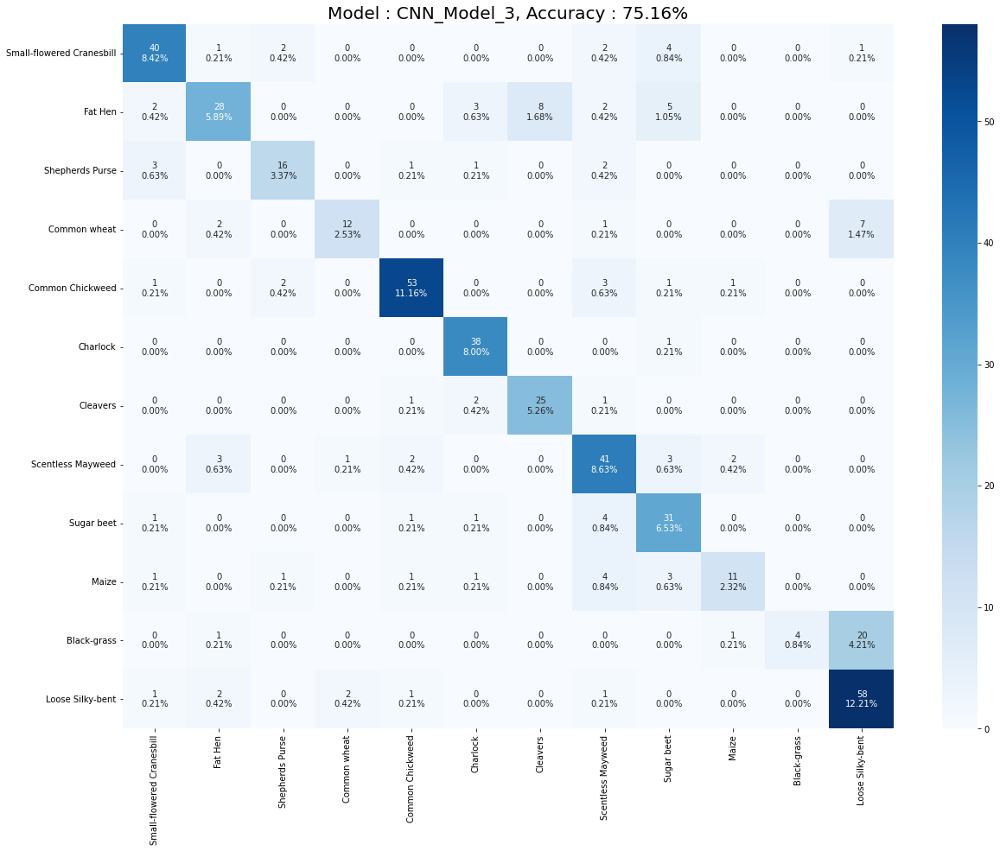

time: 1.7 s (started: 2022-02-09 16:34:18 +00:00)


In [193]:
# Show Confustion matrix for test data 

plot_model_confusion_matrix(model_input=model_cnn_3, X_test_in=X_test, y_test_in=y_test)

In [194]:
# Model Scores

display(model3_result)

,Type,# Records,Model,Accuracy,Recall,Precision,F1_score
0,Training,4275,CNN_Model_3,82.41,82.41,82.12,81.20
1,Test,475,CNN_Model_3,75.16,75.16,77.01,73.64


time: 11.2 ms (started: 2022-02-09 16:34:20 +00:00)


### **Model Observation**


* Good Accuracy Scores - **Test Accuracy Score : 80%**
* Modes slightly overfit. But Accuracy, Recall, F1 all scores are good in both Training & Testing
* Model has **3.7 Million Trainable params**, Less compared to previous CNN model that has 55.6 Million params

* Model identifies all types of seeds correctly. 

**There is still scope for improvement in the test accuracy and F1 score of the CNN model** 



# Model Performance Evaluation - Comparing all Models 


In [195]:
# All 3 Model Scores
display(model1_result,model2_result,model3_result)

,Type,# Records,Model,Accuracy,Recall,Precision,F1_score
0,Training,4275,ANN_Model_1,37.64,37.64,40.67,28.16
1,Test,475,ANN_Model_1,34.74,34.74,32.88,26.11


,Type,# Records,Model,Accuracy,Recall,Precision,F1_score
0,Training,4275,CNN_Model_2,51.74,51.74,54.55,47.13
1,Test,475,CNN_Model_2,49.05,49.05,47.14,44.15


,Type,# Records,Model,Accuracy,Recall,Precision,F1_score
0,Training,4275,CNN_Model_3,82.41,82.41,82.12,81.20
1,Test,475,CNN_Model_3,75.16,75.16,77.01,73.64


time: 25.6 ms (started: 2022-02-09 16:34:20 +00:00)


# Conclusion and key takeaways

As we have seen, **ANNs do not work well with image data**, because ANNs do not take 2-D images as input. They flatten the image and make it lose its spatial struture, whereas CNNs take the full 2D-image as input in order to perform feature extraction. So **CNNs do not lose the image's spatial structure, which makes them more suitable for working with image datasets.**

*   Model with multiple convolutional layers and multiple dense layers perform well when compare with Model with single convolutional layer and multiple dense Layers 

*   We should improve score to 90% or more and avoid overfitting so that this model can used efficiently to identify all 12 plant species.

* ANN Model does not work well with image data, As we see very low accuracy scores 

